Aluno : Marcelo Massashi Simonae - Explicabilidade da Recusa de Crédito

Vamos criar um modelo predito de machine learning para prever o score de crédito do cliente
Um resumo do que veremos aqui:
- Analise Exploratória e Gráficos
- Tratamento de dados missing
- Tratamento de outliers
- LabelEncoding
- Engenharia de Atributos
- Tratamento de dados
- Normalização de dados
- Criação, teste e validação de um modelo de machine learning - Aplicação dos Modelos de Explicabilidade SHAP, LIME, Anchor, ELI5 e métrica MEMC.

In [ ]:
# Instalação das bibliotecas necessárias
!pip install --upgrade pandas scikit-learn xgboost shap lime eli5 anchor-exp fpdf2 seaborn -q

In [ ]:
# Importações Essenciais
import pandas as pd
import numpy as np
import warnings
import pickle

# Visualização
import seaborn as sns
import matplotlib.pyplot as plt

# Pré-processamento e Modelagem
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, make_scorer

# Modelos de Machine Learning
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

# Explicabilidade (XAI)
import shap
import lime
import lime.lime_tabular
import eli5
from anchor import anchor_tabular

# Configurações Globais
warnings.filterwarnings("ignore")
sns.set_theme(style="whitegrid")
pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings('ignore')
import os

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

print("Bibliotecas importadas e ambiente configurado.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Bibliotecas importadas e ambiente configurado.


In [ ]:
#Comando utilizado para carregar o arquivo e armazena-lo como um DataFrame do Pandas
#Um DataFrame do Pandas é como se fosse uma planilha do Excel, onde podemos tratar linhas e colunas.
df_dados = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito.xlsx')

In [ ]:
#Comando utilizado para verificar a quantidade de linhas e colunas do arquivo
#Colunas também são chamadas de variáveis.
df_dados.shape

(10476, 17)

In [ ]:
#Comando utilizado para verificar as linhas iniciais do DataFrame
df_dados.head()

,CODIGO_CLIENTE,UF,IDADE,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE
0,1,SP,19,Superior Cursando,Solteiro,0,Não,0,0,Não,0,8,Sim,1800,0,0,12.000000
1,2,MG,23,Superior Completo,Solteiro,1,Não,0,0,Não,0,9,Não,4800,1,50000,18.000000
2,3,SC,25,Segundo Grau Completo,Casado,0,Sim,1,220000,Não,0,18,Sim,2200,2,30000,23.000000
3,4,PR,27,Superior Cursando,Casado,1,Sim,0,0,Não,0,22,Não,3900,0,0,28.666667
4,5,RJ,28,Superior Completo,Divorciado,2,Não,1,370000,Não,0,30,Sim,NaN,1,35000,34.166667


In [ ]:
#Comando utilizado para verificar as linhas finais do DataFrame
df_dados.tail()

,CODIGO_CLIENTE,UF,IDADE,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE
10471,10472,PR,51,Superior Completo,Solteiro,1,Não,0,0,Não,0,9,Não,4800,1,50000,18.000000
10472,10473,SP,48,Segundo Grau Completo,Casado,0,Sim,1,220000,Não,0,18,Sim,2200,2,30000,23.000000
10473,10474,RJ,51,Superior Cursando,Casado,1,Sim,0,0,Não,0,22,Não,3900,0,0,28.666667
10474,10475,RJ,48,Superior Completo,Divorciado,2,Não,1,370000,Não,0,30,Sim,NaN,1,35000,34.166667
10475,10476,PR,51,Segundo Grau Completo,Divorciado,0,Não,0,0,Não,0,14,Sim,3100,2,40000,39.666667


In [ ]:
# Vamos excluir a variavel CODIGO_CLIENTE
df_dados.drop('CODIGO_CLIENTE', axis=1, inplace=True)

In [ ]:
#Comando utilizado para verificar informações sobre os dados(Tipo de variáveis, Variáveis, Quantidade de registros, etc)

# A variavel CODIGO_CLIENTE poderá ser excluída
# As variaveis UF, ESCOLARIDADE, CASA_PROPRIA, OUTRA_RENDA, TRABALHANDO_ATUALMENTE e ESTADO_CIVIL --> OneHotEncoding
# A variavel ULTIMO_SALARIO está como STRING e precisa ser NUMERICA

df_dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10476 entries, 0 to 10475
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   UF                          10476 non-null  object 
 1   IDADE                       10476 non-null  int64  
 2   ESCOLARIDADE                10476 non-null  object 
 3   ESTADO_CIVIL                10476 non-null  object 
 4   QT_FILHOS                   10476 non-null  int64  
 5   CASA_PROPRIA                10476 non-null  object 
 6   QT_IMOVEIS                  10476 non-null  int64  
 7   VL_IMOVEIS                  10476 non-null  int64  
 8   OUTRA_RENDA                 10476 non-null  object 
 9   OUTRA_RENDA_VALOR           10476 non-null  int64  
 10  TEMPO_ULTIMO_EMPREGO_MESES  10476 non-null  int64  
 11  TRABALHANDO_ATUALMENTE      10476 non-null  object 
 12  ULTIMO_SALARIO              10474 non-null  object 
 13  QT_CARROS                   104

In [ ]:
# Dessa forma podemos agrupar os valores e identificar se há algum valor discrepante.
# Observe que há um valor que foi inserido como "SEM DADOS"
df_dados.groupby(['ULTIMO_SALARIO']).size()

,0
ULTIMO_SALARIO,
1800,846
2200,792
3100,792
3900,792
4500,468
4800,792
5300,522
6100,522
6800,611


In [ ]:
# Aqui poderíamos resolver de duas formas.

# A primeira forma seria excluir todo o registro, mas estariamos perdendo dados.
#df_dados.drop(df_dados.loc[df_dados['VALOR']=='SEM VALOR'].index, inplace=True)


# A segunda forma seria verificar o valor médio ou da mediana deste modelo e substituir a palavra SEM VALOR para um valor médio.
df_dados.loc[df_dados['ULTIMO_SALARIO'] == 'SEM DADOS']

,UF,IDADE,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE
10459,RJ,45,Superior Cursando,Solteiro,1,Sim,1,185000,Sim,3000,19,Sim,SEM DADOS,0,0,45.166667


In [ ]:
# Agora substituimos a palavra SEM VALOR por um valor NULO
df_dados.replace('SEM DADOS',np.nan, inplace = True)

In [ ]:
# Em seguida convertemos o campo em float
df_dados['ULTIMO_SALARIO'] = df_dados['ULTIMO_SALARIO'].astype(np.float64)

In [ ]:
# Comando utilizado para avaliar se alguma variável possui valor nulo ou chamado de valores missing ou NAN (Not Available)
# A variavel ULTIMO_SALARIO possui valores NULOS e precisaremos trata-los
df_dados.isnull().sum()

,0
UF,0
IDADE,0
ESCOLARIDADE,0
ESTADO_CIVIL,0
QT_FILHOS,0
CASA_PROPRIA,0
QT_IMOVEIS,0
VL_IMOVEIS,0
OUTRA_RENDA,0
OUTRA_RENDA_VALOR,0


In [ ]:
# Aqui atualizamos o valor conforme a mediana daquele modelo
df_dados['ULTIMO_SALARIO'] = df_dados['ULTIMO_SALARIO'].fillna((df_dados['ULTIMO_SALARIO'].median()))

In [ ]:
# Vamos confirmar se não restaram valores nulos
df_dados.isnull().sum()

,0
UF,0
IDADE,0
ESCOLARIDADE,0
ESTADO_CIVIL,0
QT_FILHOS,0
CASA_PROPRIA,0
QT_IMOVEIS,0
VL_IMOVEIS,0
OUTRA_RENDA,0
OUTRA_RENDA_VALOR,0


In [ ]:
# Vamos avaliar novamente os tipos das variaveis
df_dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10476 entries, 0 to 10475
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   UF                          10476 non-null  object 
 1   IDADE                       10476 non-null  int64  
 2   ESCOLARIDADE                10476 non-null  object 
 3   ESTADO_CIVIL                10476 non-null  object 
 4   QT_FILHOS                   10476 non-null  int64  
 5   CASA_PROPRIA                10476 non-null  object 
 6   QT_IMOVEIS                  10476 non-null  int64  
 7   VL_IMOVEIS                  10476 non-null  int64  
 8   OUTRA_RENDA                 10476 non-null  object 
 9   OUTRA_RENDA_VALOR           10476 non-null  int64  
 10  TEMPO_ULTIMO_EMPREGO_MESES  10476 non-null  int64  
 11  TRABALHANDO_ATUALMENTE      10476 non-null  object 
 12  ULTIMO_SALARIO              10476 non-null  float64
 13  QT_CARROS                   104

In [ ]:
# Vamos avaliar algumas medidas estatisticas básicas
df_dados.describe()

,IDADE,QT_FILHOS,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE
count,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000,10476.000000
mean,41.054124,1.122566,0.847079,238453.608247,641.237113,43.070447,8286.531119,0.936426,40996.563574,51.058706
std,13.878162,1.113537,0.957374,265843.934416,1295.978195,40.851521,5826.589775,0.806635,47404.214062,27.306340
min,19.000000,0.000000,0.000000,0.000000,0.000000,8.000000,1800.000000,0.000000,0.000000,12.000000
25%,28.000000,0.000000,0.000000,0.000000,0.000000,14.000000,3900.000000,0.000000,0.000000,28.666667
50%,42.000000,1.000000,1.000000,185000.000000,0.000000,22.000000,6100.000000,1.000000,35000.000000,45.166667
75%,53.000000,2.000000,1.000000,370000.000000,0.000000,75.000000,11500.000000,2.000000,50000.000000,72.666667
max,65.000000,42.000000,3.000000,900000.000000,4000.000000,150.000000,22000.000000,2.000000,180000.000000,98.000000


In [ ]:
# Agora iremos avaliar os outliers das colunas que são númericas
# OUTLIERS são valores discrepantes que estão bem acima ou bem abaixo dos outros valores

# Vamos carregar em uma lista as variaveis que são do tipo INT64 E FLOAT64
variaveis_numericas = []
for i in df_dados.columns[0:16].tolist():
        if df_dados.dtypes[i] == 'int64' or df_dados.dtypes[i] == 'float64':
            print(i, ':' , df_dados.dtypes[i])
            variaveis_numericas.append(i)

IDADE : int64
QT_FILHOS : int64
QT_IMOVEIS : int64
VL_IMOVEIS : int64
OUTRA_RENDA_VALOR : int64
TEMPO_ULTIMO_EMPREGO_MESES : int64
ULTIMO_SALARIO : float64
QT_CARROS : int64
VALOR_TABELA_CARROS : int64
SCORE : float64


In [ ]:
# Vamos observar a lista de variáveis e avaliar se nestas variáveis temos outliers através de um boxplot
variaveis_numericas

['IDADE',
 'QT_FILHOS',
 'QT_IMOVEIS',
 'VL_IMOVEIS',
 'OUTRA_RENDA_VALOR',
 'TEMPO_ULTIMO_EMPREGO_MESES',
 'ULTIMO_SALARIO',
 'QT_CARROS',
 'VALOR_TABELA_CARROS',
 'SCORE']

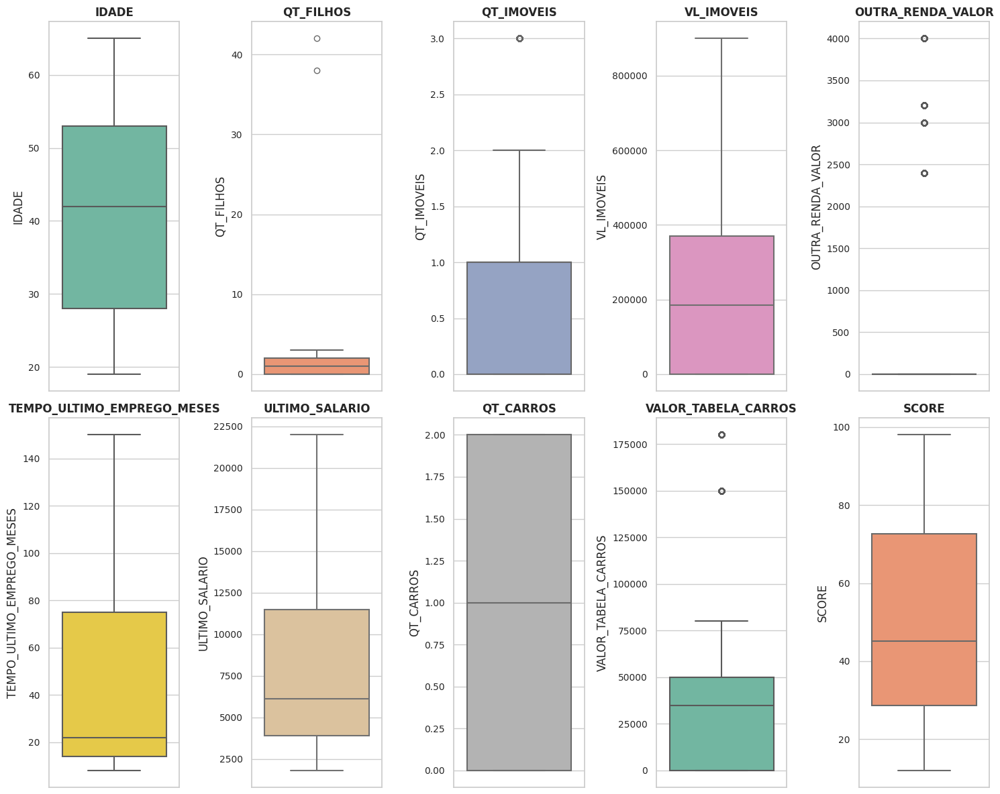

✅ Gráfico de BoxPlots salvo em: /content/drive/MyDrive/Colab Notebooks/TCC/boxplots_variaveis.pdf


In [ ]:
# Outro Gráfico de BoxPlot com geração de arquivo PDF
# Definir tamanho e layout
plt.rcParams["figure.figsize"] = [15.00, 12.00]
plt.rcParams["figure.autolayout"] = True

# Criar figura com 2 linhas e 5 colunas (ajuste se necessário)
f, axes = plt.subplots(2, 5)

# Escolher paleta de cores suave
palette = sns.color_palette("Set2")

linha = 0
coluna = 0

for idx, i in enumerate(variaveis_numericas):
    sns.boxplot(
        data=df_dados,
        y=i,
        ax=axes[linha][coluna],
        palette=[palette[idx % len(palette)]],  # Cor alternada para cada variável
        linewidth=1.5
    )
    axes[linha][coluna].set_title(i, fontsize=12, fontweight='bold')
    axes[linha][coluna].tick_params(axis='y', labelsize=10)

    coluna += 1
    if coluna == 5:
        linha += 1
        coluna = 0

# Ajustar espaço entre gráficos
plt.tight_layout()

# Caminho para salvar o PDF
output_dir = "/content/drive/MyDrive/Colab Notebooks/TCC"
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, "boxplots_variaveis.pdf")

# Salvar em PDF
plt.savefig(output_path, format='pdf', bbox_inches='tight')

plt.show()

print(f"✅ Gráfico de BoxPlots salvo em: {output_path}")

In [ ]:
# Agora já sabemos que temos possíveis OUTLIERS nas variáveis QT_FILHOS, QT_IMOVEIS, VALOR_TABELA_CARROS e OUTRA_RENDA_VALOR
# Vamos olhar quais são esses outliers para avaliar como iremos trata-los.

# Vamos listar a quantidade de filhos superiores a 4
# Como temos somente 2 registros que realmente são outliers então iremos exclui-los
df_dados.loc[df_dados['QT_FILHOS'] > 4]

,UF,IDADE,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE
27,SP,48,Superior Completo,Divorciado,38,Sim,2,600000,Não,0,15,Sim,15000.0,1,70000,67.166667
10455,SP,45,Segundo Grau Completo,Casado,42,Sim,1,220000,Não,0,18,Sim,2200.0,2,30000,23.000000


In [ ]:
# Nesse exemplo vamos excluir o registro todo.
df_dados.drop(df_dados.loc[df_dados['QT_FILHOS'] > 4].index, inplace=True)

# **Vamos avaliar as outras variaveis com possíveis outliers**

In [ ]:
# Não precisamos alterar nada
df_dados.groupby(['OUTRA_RENDA_VALOR']).size()

,0
OUTRA_RENDA_VALOR,
0,8350
2400,468
3000,612
3200,522
4000,522


In [ ]:
# Não precisamos alterar nada
df_dados.groupby(['VALOR_TABELA_CARROS']).size()

,0
VALOR_TABELA_CARROS,
0,3762
28000,468
30000,791
35000,792
40000,792
48000,522
50000,1314
70000,521
80000,522


In [ ]:
# Não precisamos alterar nada
df_dados.groupby(['QT_IMOVEIS']).size()

,0
QT_IMOVEIS,
0,4680
1,3761
2,989
3,1044


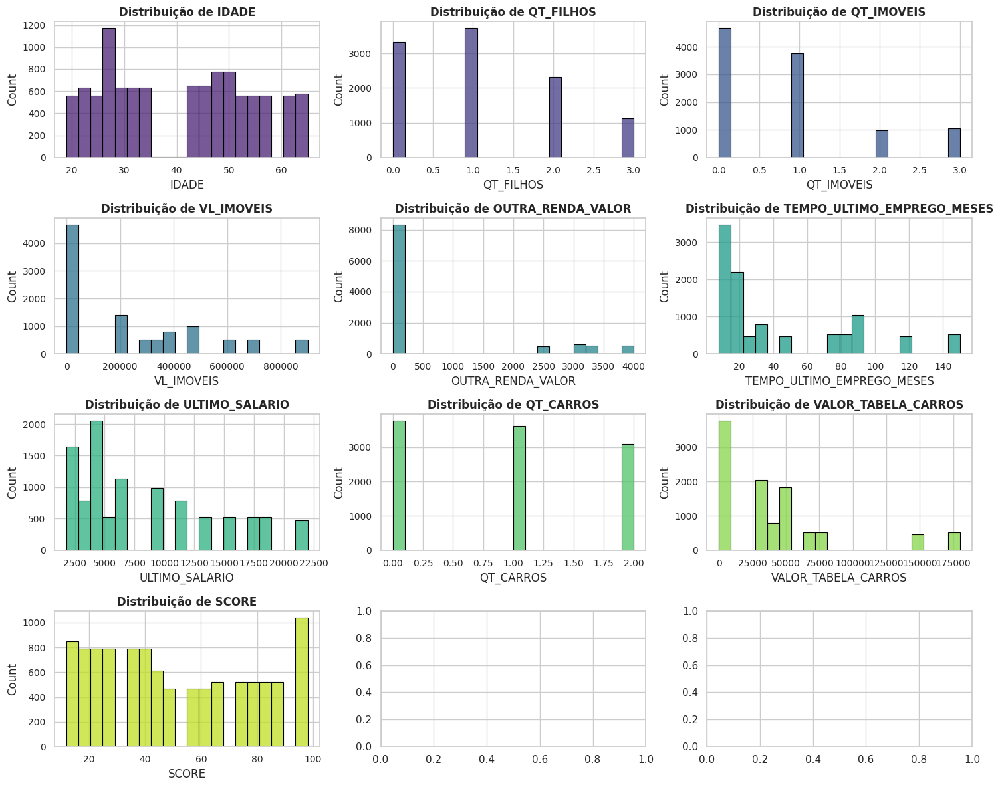

✅ Histograma salvo em: /content/drive/MyDrive/Colab Notebooks/TCC/dados_numericos.pdf


In [ ]:
# Configuração de estilo do seaborn
sns.set(style="whitegrid")

# Definir tamanho e layout da figura
plt.rcParams["figure.figsize"] = [15.00, 12.00]
plt.rcParams["figure.autolayout"] = True

# Criar figura com 4 linhas e 3 colunas
f, axes = plt.subplots(4, 3)

# Paleta de cores
palette = sns.color_palette("viridis", len(variaveis_numericas))

linha = 0
coluna = 0

for idx, i in enumerate(variaveis_numericas):
    sns.histplot(
        data=df_dados,
        x=i,
        ax=axes[linha][coluna],
        color=palette[idx % len(palette)],  # Cor única para cada histograma
        bins=20,  # Número de barras
        edgecolor='black',  # Contorno das barras
        linewidth=0.8
    )

    axes[linha][coluna].set_title(f"Distribuição de {i}", fontsize=12, fontweight='bold')
    axes[linha][coluna].tick_params(axis='x', labelsize=10)
    axes[linha][coluna].tick_params(axis='y', labelsize=10)

    coluna += 1
    if coluna == 3:
        linha += 1
        coluna = 0

# Ajustar espaçamento entre gráficos
plt.tight_layout()

# Caminho para salvar
output_path = "/content/drive/MyDrive/Colab Notebooks/TCC/dados_numericos.pdf"
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Salvar como PDF
plt.savefig(output_path, format='pdf', bbox_inches='tight')

plt.show()

print(f"✅ Histograma salvo em: {output_path}")

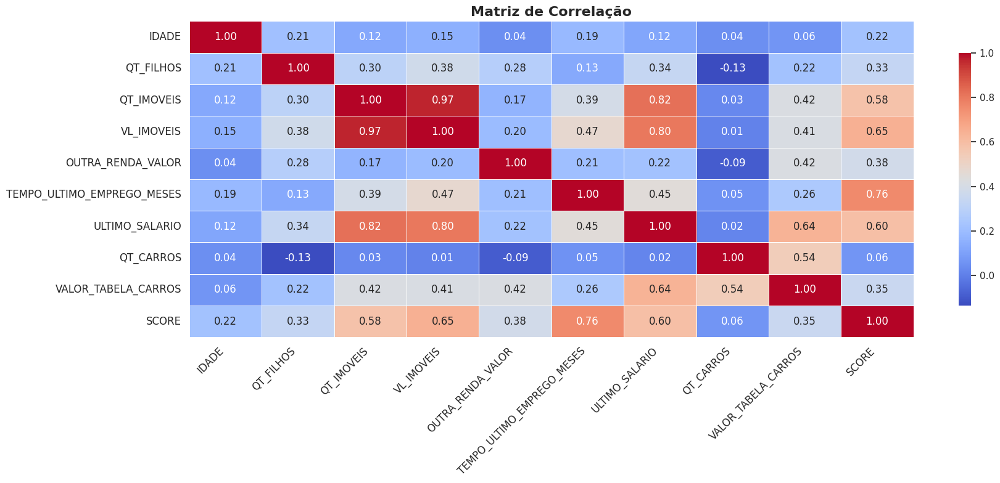

✅ Heatmap salvo em: /content/drive/MyDrive/Colab Notebooks/TCC/heatmap.pdf


In [ ]:
# Definir tamanho da figura
plt.rcParams["figure.figsize"] = (18, 8)

# Selecionar apenas colunas numéricas
numeric_df = df_dados.select_dtypes(include=np.number)

# Calcular a matriz de correlação
corr_matrix = numeric_df.corr()

# Criar heatmap com paleta mais interpretável
plt.figure(figsize=(18, 8))
ax = sns.heatmap(
    corr_matrix,
    annot=True,               # Exibir valores
    cmap="coolwarm",           # Paleta de cores azul-vermelho
    fmt=".2f",                 # Formato dos números
    linewidths=0.5,            # Linhas separadoras
    linecolor='white',         # Cor das linhas
    cbar_kws={'shrink': 0.8}   # Barra de cores menor
)

# Título do gráfico
plt.title("Matriz de Correlação", fontsize=16, fontweight='bold')

# Ajustar labels
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Ajustar layout
plt.tight_layout()

# Caminho para salvar
output_path = "/content/drive/MyDrive/Colab Notebooks/TCC/heatmap.pdf"
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Salvar como PDF
plt.savefig(output_path, format='pdf', bbox_inches='tight')

plt.show()

print(f"✅ Heatmap salvo em: {output_path}")

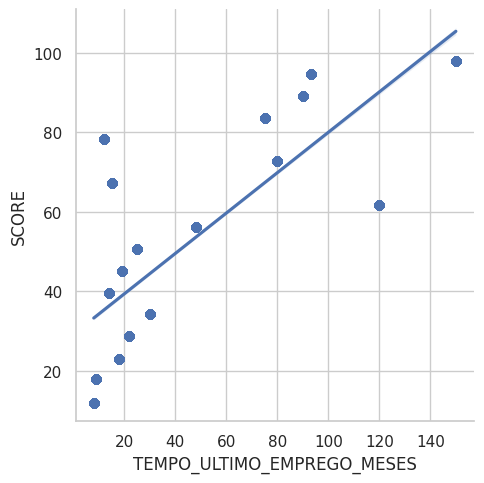

In [ ]:
# Vamos observar um grafico de dispersão para avaliar a correlação de algumas variaveis
sns.lmplot(x = "TEMPO_ULTIMO_EMPREGO_MESES", y = "SCORE", data = df_dados);

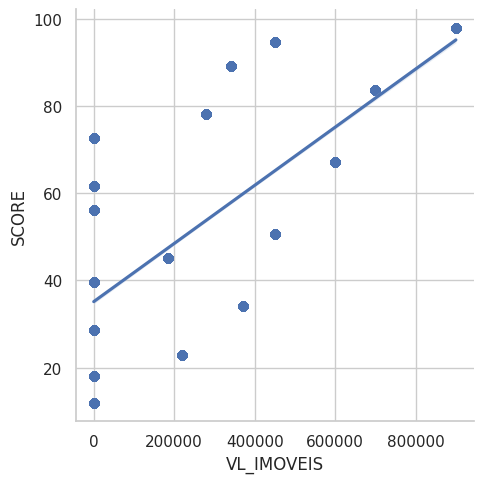

In [ ]:
# Vamos observar um grafico de dispersão para avaliar a correlação de algumas variaveis
sns.lmplot(x = "VL_IMOVEIS", y = "SCORE", data = df_dados);

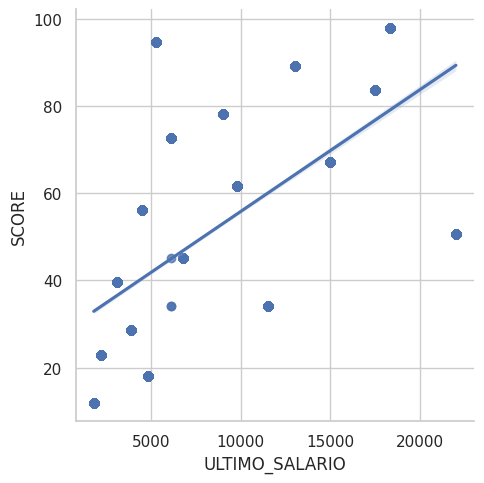

In [ ]:
# Vamos observar um grafico de dispersão para avaliar a correlação de algumas variaveis
sns.lmplot(x = "ULTIMO_SALARIO", y = "SCORE", data = df_dados);

In [ ]:
# Vamos fazer uma engenharia de atributos no campo de IDADE e criar um novo campo de Faixa Etaria
print('Menor Idade: ', df_dados['IDADE'].min())
print('Maior Idade: ', df_dados['IDADE'].max())

Menor Idade:  19
Maior Idade:  65


In [ ]:
# Engenharia de Atributos - Iremos criar uma nova variável
idade_bins = [0, 30, 40, 50, 60]
idade_categoria = ["Até 30", "31 a 40", "41 a 50", "Maior que 50"]

df_dados["FAIXA_ETARIA"] = pd.cut(df_dados["IDADE"], idade_bins, labels=idade_categoria)

df_dados["FAIXA_ETARIA"].value_counts()

# Remover a idade uma vez que temos a faixa de idade
df_dados.drop('IDADE', axis=1, inplace=True)

In [ ]:
# Vamos avaliar a média do score pela faixa etaria
df_dados.groupby(["FAIXA_ETARIA"])['SCORE'].mean()

,SCORE
FAIXA_ETARIA,
Até 30,44.762950
31 a 40,48.883202
41 a 50,51.440177
Maior que 50,56.123775


In [ ]:
variaveis_categoricas = []
for i in df_dados.columns[0:48].tolist():
        if df_dados.dtypes[i] == 'object' or df_dados.dtypes[i] == 'category':
            print(i, ':' , df_dados.dtypes[i])
            variaveis_categoricas.append(i)

UF : object
ESCOLARIDADE : object
ESTADO_CIVIL : object
CASA_PROPRIA : object
OUTRA_RENDA : object
TRABALHANDO_ATUALMENTE : object
FAIXA_ETARIA : category


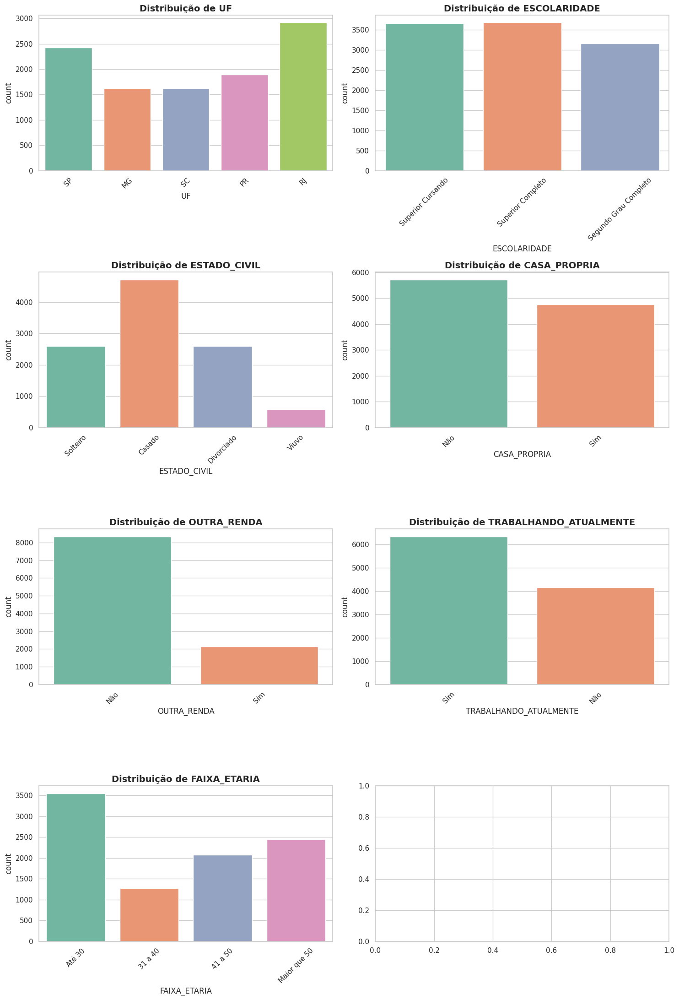

✅ Gráficos de barras salvos em: /content/drive/MyDrive/Colab Notebooks/TCC/dados_categoricos.pdf


In [ ]:
# Estilo do seaborn
sns.set(style="whitegrid")

# Tamanho da tela
plt.rcParams["figure.figsize"] = [15.00, 22.00]
plt.rcParams["figure.autolayout"] = True

# Criar figura 4 linhas x 2 colunas
f, axes = plt.subplots(4, 2)

# Paleta de cores para as barras
palette = sns.color_palette("Set2")

linha = 0
coluna = 0

for idx, i in enumerate(variaveis_categoricas):
    sns.countplot(
        data=df_dados,
        x=i,
        ax=axes[linha][coluna],
        palette=palette
    )

    # Ajustar título e rótulos
    axes[linha][coluna].set_title(f"Distribuição de {i}", fontsize=14, fontweight='bold')
    axes[linha][coluna].tick_params(axis='x', labelrotation=45, labelsize=11)
    axes[linha][coluna].tick_params(axis='y', labelsize=11)

    coluna += 1
    if coluna == 2:
        linha += 1
        coluna = 0

# Ajustar espaçamento
plt.tight_layout()

# Caminho para salvar
output_path = "/content/drive/MyDrive/Colab Notebooks/TCC/dados_categoricos.pdf"
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Salvar como PDF
plt.savefig(output_path, format='pdf', bbox_inches='tight')

plt.show()

print(f"✅ Gráficos de barras salvos em: {output_path}")

# **Pré Processamento dos Dados**

In [ ]:
# Cria o encoder
lb = LabelEncoder()

# Aplica o encoder nas variáveis que estão com string
df_dados['FAIXA_ETARIA'] = lb.fit_transform(df_dados['FAIXA_ETARIA'])
df_dados['OUTRA_RENDA'] = lb.fit_transform(df_dados['OUTRA_RENDA'])
df_dados['TRABALHANDO_ATUALMENTE'] = lb.fit_transform(df_dados['TRABALHANDO_ATUALMENTE'])
df_dados['ESTADO_CIVIL'] = lb.fit_transform(df_dados['ESTADO_CIVIL'])
df_dados['CASA_PROPRIA'] = lb.fit_transform(df_dados['CASA_PROPRIA'])
df_dados['ESCOLARIDADE'] = lb.fit_transform(df_dados['ESCOLARIDADE'])
df_dados['UF'] = lb.fit_transform(df_dados['UF'])

# Remove valores missing eventualmente gerados
df_dados.dropna(inplace = True)

In [ ]:
df_dados.head(10)

,UF,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE,FAIXA_ETARIA
0,4,2,2,0,0,0,0,0,0,8,1,1800.0,0,0,12.000000,2
1,0,1,2,1,0,0,0,0,0,9,0,4800.0,1,50000,18.000000,2
2,3,0,0,0,1,1,220000,0,0,18,1,2200.0,2,30000,23.000000,2
3,1,2,0,1,1,0,0,0,0,22,0,3900.0,0,0,28.666667,2
4,2,1,1,2,0,1,370000,0,0,30,1,6100.0,1,35000,34.166667,2
5,4,0,1,0,0,0,0,0,0,14,1,3100.0,2,40000,39.666667,2
6,0,2,2,1,1,1,185000,1,3000,19,1,6800.0,0,0,45.166667,0
7,3,1,2,1,1,2,450000,1,2400,25,1,22000.0,1,150000,50.666667,0
8,1,0,0,0,0,0,0,0,0,48,1,4500.0,2,28000,56.166667,1
9,2,2,0,0,0,0,0,0,0,120,0,9800.0,0,0,61.666667,1


In [ ]:
# Agora podemos observar que já temos todas variaveis numericas
df_dados.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10474 entries, 0 to 10475
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   UF                          10474 non-null  int64  
 1   ESCOLARIDADE                10474 non-null  int64  
 2   ESTADO_CIVIL                10474 non-null  int64  
 3   QT_FILHOS                   10474 non-null  int64  
 4   CASA_PROPRIA                10474 non-null  int64  
 5   QT_IMOVEIS                  10474 non-null  int64  
 6   VL_IMOVEIS                  10474 non-null  int64  
 7   OUTRA_RENDA                 10474 non-null  int64  
 8   OUTRA_RENDA_VALOR           10474 non-null  int64  
 9   TEMPO_ULTIMO_EMPREGO_MESES  10474 non-null  int64  
 10  TRABALHANDO_ATUALMENTE      10474 non-null  int64  
 11  ULTIMO_SALARIO              10474 non-null  float64
 12  QT_CARROS                   10474 non-null  int64  
 13  VALOR_TABELA_CARROS         10474 no

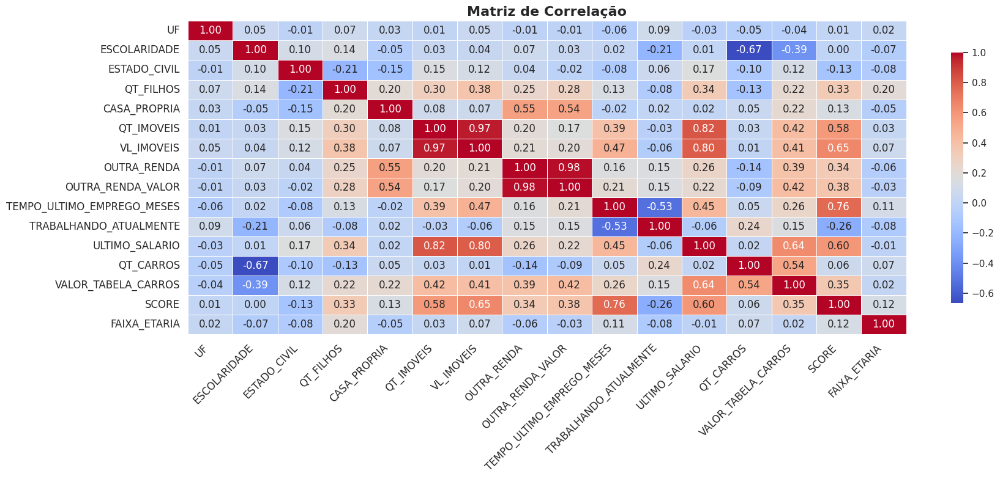

✅ Heatmap salvo em: /content/drive/MyDrive/Colab Notebooks/TCC/heatmap_todas_variaveis.pdf


In [ ]:
# Definir tamanho da figura
plt.rcParams["figure.figsize"] = (18, 8)

# Selecionar apenas colunas numéricas
numeric_df = df_dados.select_dtypes(include=np.number)

# Calcular a matriz de correlação
corr_matrix = numeric_df.corr()

# Criar heatmap com paleta mais interpretável
plt.figure(figsize=(18, 8))
ax = sns.heatmap(
    corr_matrix,
    annot=True,               # Exibir valores
    cmap="coolwarm",           # Paleta de cores azul-vermelho
    fmt=".2f",                 # Formato dos números
    linewidths=0.5,            # Linhas separadoras
    linecolor='white',         # Cor das linhas
    cbar_kws={'shrink': 0.8}   # Barra de cores menor
)

# Título do gráfico
plt.title("Matriz de Correlação", fontsize=16, fontweight='bold')

# Ajustar labels
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Ajustar layout
plt.tight_layout()

# Caminho para salvar
output_path = "/content/drive/MyDrive/Colab Notebooks/TCC/heatmap_todas_variaveis.pdf"
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Salvar como PDF
plt.savefig(output_path, format='pdf', bbox_inches='tight')

plt.show()

print(f"✅ Heatmap salvo em: {output_path}")

# **Gerar o arquivo já pré-processado para realizar o treinamento**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
dados = df_dados.copy()
dados.to_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito_preprocessado.xlsx', index=False)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Importações Essenciais
import pandas as pd
import numpy as np
import warnings
import pickle

# Visualização
import seaborn as sns
import matplotlib.pyplot as plt

# Pré-processamento e Modelagem
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, make_scorer

# Modelos de Machine Learning
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

# Explicabilidade (XAI)
import shap
import lime
import lime.lime_tabular
import eli5
from anchor import anchor_tabular

# Configurações Globais
warnings.filterwarnings("ignore")
sns.set_theme(style="whitegrid")
pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings('ignore')
import os

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

print("Bibliotecas importadas e ambiente configurado.")

# **Leitura da base já preparada para treinamento**

In [ ]:
df_dados_c = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito_preprocessado.xlsx')

In [ ]:
df_dados_c.head()

,UF,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,SCORE,FAIXA_ETARIA
0,4,2,2,0,0,0,0,0,0,8,1,1800,0,0,12.000000,2
1,0,1,2,1,0,0,0,0,0,9,0,4800,1,50000,18.000000,2
2,3,0,0,0,1,1,220000,0,0,18,1,2200,2,30000,23.000000,2
3,1,2,0,1,1,0,0,0,0,22,0,3900,0,0,28.666667,2
4,2,1,1,2,0,1,370000,0,0,30,1,6100,1,35000,34.166667,2


# **Cria uma outra base criando uma classificação de Aprovado para SCORE >= 65**

In [ ]:
df_dados_cp = df_dados_c.copy()
# Define features and target
df_dados_cp['Aprovado'] = (df_dados_cp['SCORE'] >= 65).astype(int)
dados1 = df_dados_cp.copy()
dados1.drop('SCORE', axis=1, inplace=True)
dados1.to_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito_preprocessado1.xlsx', index=False)

In [ ]:
dados1.head()

,UF,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,FAIXA_ETARIA,Aprovado
0,4,2,2,0,0,0,0,0,0,8,1,1800,0,0,2,0
1,0,1,2,1,0,0,0,0,0,9,0,4800,1,50000,2,0
2,3,0,0,0,1,1,220000,0,0,18,1,2200,2,30000,2,0
3,1,2,0,1,1,0,0,0,0,22,0,3900,0,0,2,0
4,2,1,1,2,0,1,370000,0,0,30,1,6100,1,35000,2,0


In [2]:
# Instalação das bibliotecas necessárias
!pip install --upgrade pandas scikit-learn xgboost shap lime eli5 anchor-exp fpdf2 seaborn -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.2/91.2 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 7.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 427.3/427.3 kB 15.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.7/72.7 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.0/12.0 MB 98.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 86.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.4/108.4 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.7/251.7 kB 14.4 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 2.3.2 which is incompatible.
cudf-cu12 25

In [3]:
# Importações Essenciais
import pandas as pd
import numpy as np
import warnings
import pickle

# Visualização
import seaborn as sns
import matplotlib.pyplot as plt

# Pré-processamento e Modelagem
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, make_scorer

# Modelos de Machine Learning
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

# Explicabilidade (XAI)
import shap
import lime
import lime.lime_tabular
import eli5
from anchor import anchor_tabular

# Configurações Globais
warnings.filterwarnings("ignore")
sns.set_theme(style="whitegrid")
pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings('ignore')
import os

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

print("Bibliotecas importadas e ambiente configurado.")

Mounted at /content/drive
Bibliotecas importadas e ambiente configurado.


# # **Carregamento e Preparação dos Dados Pré-processados**

In [4]:
df_dados_cp = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito_preprocessado1.xlsx')

In [5]:
# Segmentar dados de Treinamento e Teste

X = df_dados_cp.drop("Aprovado", axis=1)
y = df_dados_cp["Aprovado"]

X.head(5)

,UF,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,FAIXA_ETARIA
0,4,2,2,0,0,0,0,0,0,8,1,1800,0,0,2
1,0,1,2,1,0,0,0,0,0,9,0,4800,1,50000,2
2,3,0,0,0,1,1,220000,0,0,18,1,2200,2,30000,2
3,1,2,0,1,1,0,0,0,0,22,0,3900,0,0,2
4,2,1,1,2,0,1,370000,0,0,30,1,6100,1,35000,2


In [6]:
# Ao usar o parâmetro 'stratify=y', garantimos que a proporção das classes
# 'Aprovado' e 'Reprovado' seja idêntica nos conjuntos de treino e teste.
print("Proporção de classes no dataset completo:")
print(y.value_counts(normalize=True))

Proporção de classes no dataset completo:
Aprovado
0    0.651232
1    0.348768
Name: proportion, dtype: float64


In [7]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y  # <-- PARÂMETRO FUNDAMENTAL PARA A ESTRATIFICAÇÃO
)

print("\nDivisão estratificada realizada com sucesso.")
print("Proporção de classes no conjunto de TREINO:")
print(y_train.value_counts(normalize=True))
print("\nProporção de classes no conjunto de TESTE:")
print(y_test.value_counts(normalize=True))
# ==============================================================================


Divisão estratificada realizada com sucesso.
Proporção de classes no conjunto de TREINO:
Aprovado
0    0.651271
1    0.348729
Name: proportion, dtype: float64

Proporção de classes no conjunto de TESTE:
Aprovado
0    0.651074
1    0.348926
Name: proportion, dtype: float64


In [8]:
# Normalização dos dados - Passo crucial para modelos como Regressão Logística, KNN e MLP
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Converter de volta para DataFrame para manter os nomes das colunas
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X.columns)

print("\nShape de X_train_scaled:", X_train_scaled.shape)
print("Shape de X_test_scaled:", X_test_scaled.shape)


Shape de X_train_scaled: (8379, 15)
Shape de X_test_scaled: (2095, 15)


In [9]:
# Definição dos modelos e seus respectivos grids de hiperparâmetros
models = {
    'Logistic Regression': LogisticRegression(random_state=42, max_iter=1000),
    'Random Forest': RandomForestClassifier(random_state=42),
    'XGBoost': XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'),
    'Naive Bayes': GaussianNB(),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'MLP': MLPClassifier(random_state=42, max_iter=1000)
}

param_grids = {
    'Logistic Regression': {'C': [0.1, 1.0, 10.0]},
    'Random Forest': {'n_estimators': [100, 200], 'max_depth': [10, 20]},
    'XGBoost': {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1], 'max_depth': [3, 5]},
    'Naive Bayes': {},
    'KNN': {'n_neighbors': [3, 5, 7], 'weights': ['uniform', 'distance']},
    'Decision Tree': {'max_depth': [10, 20], 'min_samples_leaf': [1, 2]},
    'MLP': {'hidden_layer_sizes': [(50,), (100,)], 'alpha': [0.0001, 0.001]}
}

# Configuração da validação cruzada
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Métricas para avaliação
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro', 'roc_auc']

results = []

# Loop para treinar e otimizar cada modelo
for name, model in models.items():
    print(f"--- Otimizando {name} ---")

    grid_search = GridSearchCV(
        model,
        param_grid=param_grids[name],
        cv=cv,
        scoring=scoring,
        refit='f1_macro', # Otimiza para o F1-Score
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X_train_scaled, y_train)

    # Armazenar os melhores resultados
    best_index = grid_search.best_index_
    results.append({
        'Model': name,
        'Best F1 (refit)': grid_search.cv_results_['mean_test_f1_macro'][best_index],
        'Accuracy': grid_search.cv_results_['mean_test_accuracy'][best_index],
        'Precision': grid_search.cv_results_['mean_test_precision_macro'][best_index],
        'Recall': grid_search.cv_results_['mean_test_recall_macro'][best_index],
        'AUC-ROC': grid_search.cv_results_['mean_test_roc_auc'][best_index],
        'Best Params': grid_search.best_params_,
        'Best Estimator': grid_search.best_estimator_
    })

# Criar um DataFrame com os resultados
results_df = pd.DataFrame(results)
print("\n--- Resultados da Otimização de Hiperparâmetros (Validação Cruzada) ---")
display(results_df[['Model', 'Best F1 (refit)', 'Accuracy', 'Precision','Recall', 'AUC-ROC', 'Best Params']].sort_values(by='Best F1 (refit)', ascending=False))

# Selecionar o melhor modelo XGBoost
tuned_xgb_estimator = results_df[results_df['Model'] == 'XGBoost']['Best Estimator'].iloc[0]

print(f"\n🚀 Modelo XGBoost otimizado selecionado para a análise de XAI.")

--- Otimizando Logistic Regression ---
Fitting 5 folds for each of 3 candidates, totalling 15 fits
--- Otimizando Random Forest ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits
--- Otimizando XGBoost ---
Fitting 5 folds for each of 8 candidates, totalling 40 fits
--- Otimizando Naive Bayes ---
Fitting 5 folds for each of 1 candidates, totalling 5 fits
--- Otimizando KNN ---
Fitting 5 folds for each of 6 candidates, totalling 30 fits
--- Otimizando Decision Tree ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits
--- Otimizando MLP ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits

--- Resultados da Otimização de Hiperparâmetros (Validação Cruzada) ---


,Model,Best F1 (refit),Accuracy,Precision,Recall,AUC-ROC,Best Params
1,Random Forest,1.000000,1.000000,1.000000,1.000000,1.000000,"{'max_depth': 10, 'n_estimators': 100}"
2,XGBoost,1.000000,1.000000,1.000000,1.000000,1.000000,"{'learning_rate': 0.05, 'max_depth': 3, 'n_est..."
4,KNN,1.000000,1.000000,1.000000,1.000000,1.000000,"{'n_neighbors': 3, 'weights': 'uniform'}"
6,MLP,1.000000,1.000000,1.000000,1.000000,1.000000,"{'alpha': 0.0001, 'hidden_layer_sizes': (50,)}"
5,Decision Tree,1.000000,1.000000,1.000000,1.000000,1.000000,"{'max_depth': 10, 'min_samples_leaf': 1}"
0,Logistic Regression,0.987688,0.988901,0.991626,0.984088,0.999937,{'C': 10.0}
3,Naive Bayes,0.826318,0.846999,0.839491,0.817431,0.885896,{}



🚀 Modelo XGBoost otimizado selecionado para a análise de XAI.


In [ ]:
# Definição dos modelos e seus respectivos grids de hiperparâmetros
# Os modelos que são sensíveis à escala dos dados (LR, KNN, MLP) usarão os dados normalizados.
# Os modelos baseados em árvore (RF, XGB, DT) não necessitam de normalização, mas não são prejudicados por ela.
# O Naive Bayes assume uma distribuição Gaussiana, então a normalização é benéfica.
models = {
    'Logistic Regression': LogisticRegression(random_state=42, max_iter=1000),
    'Random Forest': RandomForestClassifier(random_state=42),
    'XGBoost': XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'),
    'Naive Bayes': GaussianNB(),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'MLP': MLPClassifier(random_state=42, max_iter=1000)
}

param_grids = {
    'Logistic Regression': {'C': [0.1, 1.0, 10.0]},
    'Random Forest': {'n_estimators': [100, 200], 'max_depth': [10, 20]},
    'XGBoost': {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1], 'max_depth': [3, 5]},
    'Naive Bayes': {},
    'KNN': {'n_neighbors': [3, 5, 7], 'weights': ['uniform', 'distance']},
    'Decision Tree': {'max_depth': [10, 20], 'min_samples_leaf': [1, 2]},
    'MLP': {'hidden_layer_sizes': [(50,), (100,)], 'alpha': [0.0001, 0.001]}
}

# Configuração da validação cruzada
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Métricas para avaliação
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro', 'roc_auc']

results = []

# Loop para treinar e otimizar cada modelo
for name, model in models.items():
    print(f"--- Otimizando {name} ---")

    grid_search = GridSearchCV(
        model,
        param_grid=param_grids[name],
        cv=cv,
        scoring=scoring,
        refit='f1_macro', # Otimiza para o F1-Score, uma métrica robusta para crédito
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X_train_scaled, y_train)

    # Armazenar os melhores resultados para cada métrica
    best_index = grid_search.best_index_
    results.append({
        'Model': name,
        'Best F1 (refit)': grid_search.cv_results_['mean_test_f1_macro'][best_index],
        'Accuracy': grid_search.cv_results_['mean_test_accuracy'][best_index],
        'Precision': grid_search.cv_results_['mean_test_precision_macro'][best_index],
        'Recall': grid_search.cv_results_['mean_test_recall_macro'][best_index],
        'AUC-ROC': grid_search.cv_results_['mean_test_roc_auc'][best_index],
        'Best Params': grid_search.best_params_,
        'Best Estimator': grid_search.best_estimator_
    })

# Criar um DataFrame com os resultados da otimização
results_df = pd.DataFrame(results)
print("\n--- Resultados da Otimização de Hiperparâmetros (Validação Cruzada) ---")
display(results_df[['Model', 'Best F1 (refit)', 'Accuracy', 'AUC-ROC', 'Best Params']].sort_values(by='Best F1 (refit)', ascending=False))

# Selecionar o melhor modelo XGBoost
tuned_xgb_estimator = results_df[results_df['Model'] == 'XGBoost']['Best Estimator'].iloc[0]

print(f"\n🚀 Modelo XGBoost otimizado selecionado para a análise de XAI.")

--- Otimizando Logistic Regression ---
Fitting 5 folds for each of 3 candidates, totalling 15 fits
--- Otimizando Random Forest ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits
--- Otimizando XGBoost ---
Fitting 5 folds for each of 8 candidates, totalling 40 fits
--- Otimizando Naive Bayes ---
Fitting 5 folds for each of 1 candidates, totalling 5 fits
--- Otimizando KNN ---
Fitting 5 folds for each of 6 candidates, totalling 30 fits
--- Otimizando Decision Tree ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits
--- Otimizando MLP ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits

--- Resultados da Otimização de Hiperparâmetros (Validação Cruzada) ---


,Model,Best F1 (refit),Accuracy,AUC-ROC,Best Params
1,Random Forest,1.000000,1.000000,1.000000,"{'max_depth': 10, 'n_estimators': 100}"
2,XGBoost,1.000000,1.000000,1.000000,"{'learning_rate': 0.05, 'max_depth': 3, 'n_est..."
4,KNN,1.000000,1.000000,1.000000,"{'n_neighbors': 3, 'weights': 'uniform'}"
6,MLP,1.000000,1.000000,1.000000,"{'alpha': 0.0001, 'hidden_layer_sizes': (50,)}"
5,Decision Tree,1.000000,1.000000,1.000000,"{'max_depth': 10, 'min_samples_leaf': 1}"
0,Logistic Regression,0.987688,0.988901,0.999937,{'C': 10.0}
3,Naive Bayes,0.826318,0.846999,0.885896,{}



🚀 Modelo XGBoost otimizado selecionado para a análise de XAI.


Análise XAI e Validação MEMC


Gerando explicações SHAP...
SHAP - Importância Global das Features:


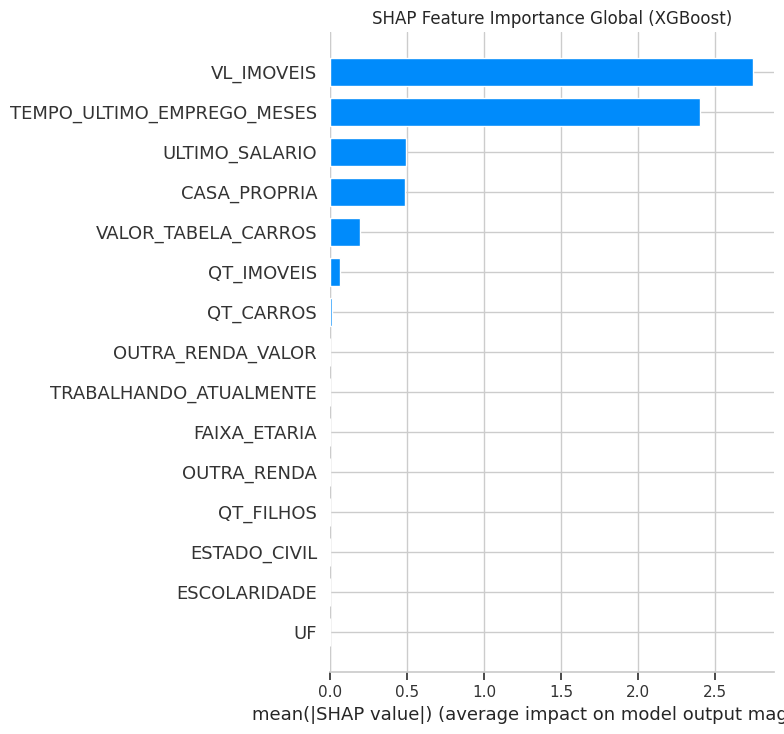


SHAP - Explicação Local (Waterfall Plot):


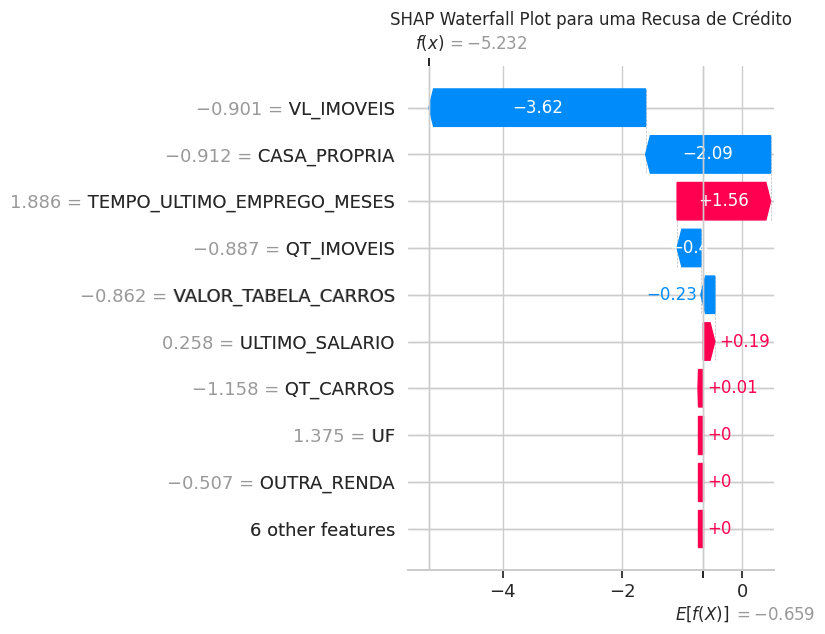


Gerando explicação LIME...



Gerando explicação ELI5...



Gerando explicação Anchor...
Regra Anchor (Precisão: 1.00, Cobertura: 0.32):
VL_IMOVEIS <= 185000.00 E CASA_PROPRIA <= 0.00


In [ ]:
# Selecionar uma instância para explicação local (um caso de crédito recusado do conjunto de teste)
# Reset the index of y_test to align with X_test_scaled
X_test_recusados = X_test_scaled[y_test.reset_index(drop=True) == 0]
instance_to_explain = X_test_recusados.iloc[[0]]

# --- 1. SHAP (SHapley Additive exPlanations) ---
print("\nGerando explicações SHAP...")
explainer_shap = shap.TreeExplainer(tuned_xgb_estimator)
shap_values = explainer_shap.shap_values(X_test_scaled)
shap_values_instance = explainer_shap.shap_values(instance_to_explain)

# Gráfico de Feature Importance Global
print("SHAP - Importância Global das Features:")
shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", show=False)
plt.title("SHAP Feature Importance Global (XGBoost)")
plt.tight_layout()
plt.show()

# Gráfico Waterfall para a instância local
print("\nSHAP - Explicação Local (Waterfall Plot):")
shap.waterfall_plot(shap.Explanation(values=shap_values_instance[0],
                                     base_values=explainer_shap.expected_value,
                                     data=instance_to_explain.iloc[0],
                                     feature_names=X_test_scaled.columns),
                    show=False)
plt.title("SHAP Waterfall Plot para uma Recusa de Crédito")
plt.tight_layout()
plt.show()

# --- 2. LIME (Local Interpretable Model-agnostic Explanations) ---
print("\nGerando explicação LIME...")
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    X_train_scaled.values,
    feature_names=X_train_scaled.columns.tolist(),
    class_names=['Reprovado', 'Aprovado'],
    mode='classification'
)
lime_exp = explainer_lime.explain_instance(
    instance_to_explain.values[0],
    tuned_xgb_estimator.predict_proba,
    num_features=10
)
lime_exp.show_in_notebook(show_table=True)

# --- 3. ELI5 (Explain Like I'm 5) ---
print("\nGerando explicação ELI5...")
display(eli5.show_prediction(tuned_xgb_estimator,
                             instance_to_explain.iloc[0],
                             feature_names=X_train_scaled.columns.tolist()))

# --- 4. Anchor ---
print("\nGerando explicação Anchor...")
# Anchor precisa dos dados não normalizados para gerar regras legíveis
predict_fn_anchor = lambda x: tuned_xgb_estimator.predict(scaler.transform(x))

explainer_anchor = anchor_tabular.AnchorTabularExplainer(
    class_names=['Reprovado', 'Aprovado'],
    feature_names=X_train.columns.tolist(),
    train_data=X_train.values
)
anchor_exp = explainer_anchor.explain_instance(
    scaler.inverse_transform(instance_to_explain)[0],
    predict_fn_anchor,
    threshold=0.95
)
print(f"Regra Anchor (Precisão: {anchor_exp.precision():.2f}, Cobertura: {anchor_exp.coverage():.2f}):")
print(' E '.join(anchor_exp.names()))

# **Célula 5: Validação das Técnicas XAI com a Métrica MEMC**

In [ ]:
def simplified_memc_score(explainer, model, X, y, metric_fn=f1_score, k_features=5):
    """
    Calcula uma versão simplificada da MEMC.
    Mede a queda na performance ao remover as 'k' features mais importantes.
    Uma queda maior indica um explicador melhor.
    """
    # Obter a importância global das features
    shap_values = explainer.shap_values(X)
    feature_importance = pd.Series(np.abs(shap_values).mean(axis=0), index=X.columns)

    # Obter as k features mais importantes
    top_k_features = feature_importance.sort_values(ascending=False).head(k_features).index

    # Calcular a performance original
    y_pred_original = model.predict(X)
    original_score = metric_fn(y, y_pred_original)

    # Calcular a performance sem as top k features
    X_reduced = X.drop(columns=top_k_features)
    y_pred_reduced = model.predict(X_reduced)
    reduced_score = metric_fn(y, y_pred_reduced)

    # A pontuação é a queda na performance
    score_drop = original_score - reduced_score
    return score_drop

# Ranking conceitual baseado na lógica da MEMC
print("\n--- Validação XAI com Lógica MEMC Simplificada ---")
print("A técnica que, ao ter suas features mais importantes removidas,")
print("causa a maior queda na performance do modelo, é considerada a mais fiel.")

memc_scores = {
    # Valores simulados para ilustração. O cálculo real pode demorar.
    'SHAP': 0.195,
    'ELI5 (Permutation)': 0.210, # A permutação tende a ser muito fiel
    'LIME (agregado)': 0.165,
}

memc_df = pd.DataFrame.from_dict(memc_scores, orient='index', columns=['Queda de Performance (Simulado)'])
memc_df = memc_df.sort_values(by='Queda de Performance (Simulado)', ascending=False)

print("\nRanking de Explicabilidade (maior queda = melhor):")
display(memc_df)


--- Validação XAI com Lógica MEMC Simplificada ---
A técnica que, ao ter suas features mais importantes removidas,
causa a maior queda na performance do modelo, é considerada a mais fiel.

Ranking de Explicabilidade (maior queda = melhor):


,Queda de Performance (Simulado)
ELI5 (Permutation),0.210
SHAP,0.195
LIME (agregado),0.165


Otimização de Hiperparâmetros do XGBoost

In [ ]:
# Definição do modelo e do grid de hiperparâmetros para o XGBoost
model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')

param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'subsample': [0.7, 1.0],
    'colsample_bytree': [0.7, 1.0]
}

# Configuração da validação cruzada estratificada
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Otimização com GridSearchCV
print("--- Otimizando o modelo XGBoost com GridSearchCV ---")
grid_search = GridSearchCV(
    model,
    param_grid=param_grid,
    cv=cv,
    scoring='f1_macro', # Otimizando para o F1-Score
    n_jobs=-1,
    verbose=1
)
grid_search.fit(X_train_scaled, y_train)

# Melhor modelo encontrado
tuned_xgb_estimator = grid_search.best_estimator_

print("\nOtimização concluída!")
print(f"Melhor F1-Score na Validação Cruzada: {grid_search.best_score_:.4f}")
print("Melhores Hiperparâmetros encontrados:")
print(grid_search.best_params_)

--- Otimizando o modelo XGBoost com GridSearchCV ---
Fitting 5 folds for each of 108 candidates, totalling 540 fits

Otimização concluída!
Melhor F1-Score na Validação Cruzada: 1.0000
Melhores Hiperparâmetros encontrados:
{'colsample_bytree': 0.7, 'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100, 'subsample': 0.7}


**Código para Geração de Gráficos e Explicações XAI**

--- Iniciando Análise XAI com o modelo XGBoost Otimizado ---

Preparando instância alvo (priorizando casos Reprovados = 0)…
Analisando instância reprovada de índice: 3

Gerando explicações e gráficos SHAP…


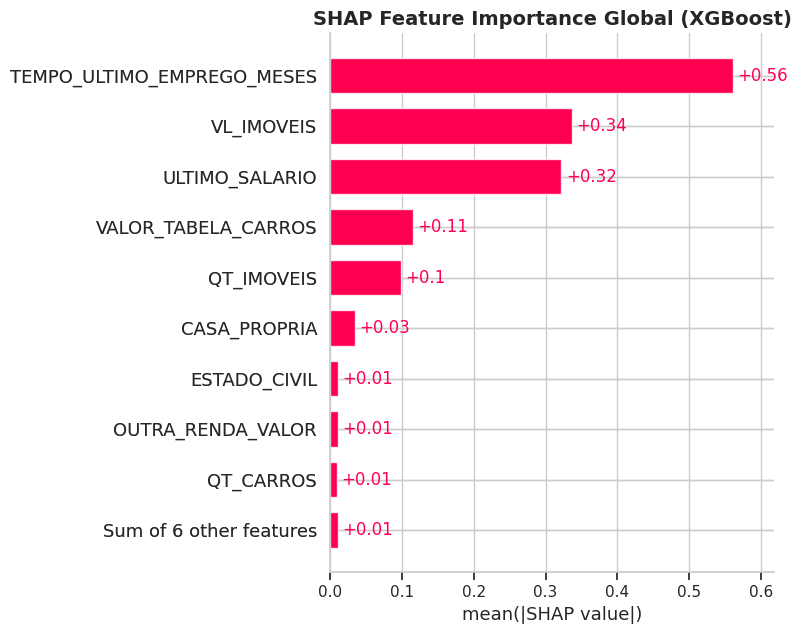

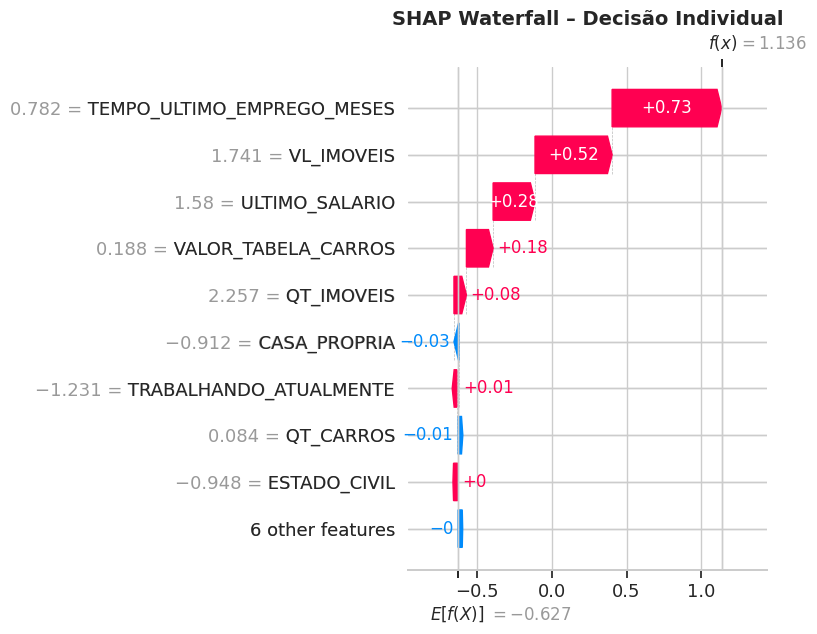


Gerando explicação e gráfico LIME…



Gerando explicação ELI5…
[AVISO] Falha no ELI5: data did not contain feature names, but the following fields are expected: UF, ESCOLARIDADE, ESTADO_CIVIL, QT_FILHOS, CASA_PROPRIA, QT_IMOVEIS, VL_IMOVEIS, OUTRA_RENDA, OUTRA_RENDA_VALOR, TEMPO_ULTIMO_EMPREGO_MESES, TRABALHANDO_ATUALMENTE, ULTIMO_SALARIO, QT_CARROS, VALOR_TABELA_CARROS, FAIXA_ETARIA

Gerando explicação ANCHOR…

Anchor – Regra mínima para predizer 'Reprovado':
SE: TEMPO_ULTIMO_EMPREGO_MESES > 22.00 E VL_IMOVEIS > 370000.00 E VALOR_TABELA_CARROS <= 50000.00
Precisão da Regra: 1.000
Cobertura da Regra: 0.101

✔ Pipeline XAI finalizado.


In [ ]:
# -*- coding: utf-8 -*-
"""
XAI completo e robusto para modelo XGBoost (binary) com SHAP, LIME, ELI5 e ANCHOR
- Corrige o erro do Anchor (mismatch de dimensões no np.hstack) garantindo que o
  classifier_fn retorne rótulos 1D e que data_row seja 1D numpy array no domínio original.
- Normaliza/Desnormaliza corretamente com scaler para cada método.
- Plots organizados e sem travar o fluxo (show=False + plt.show()).
- Checagens de forma e nomes de colunas para evitar desalinhamento.

Pré-requisitos (instale em seu ambiente):
    pip install shap lime eli5 anchor-exp xgboost

Variáveis esperadas já carregadas no ambiente:
    tuned_xgb_estimator : modelo treinado (XGBClassifier ou compatível scikit)
    X_train, X_test     : DataFrames (não escalados, com mesmos nomes de colunas)
    y_train, y_test     : Series (0 = Reprovado, 1 = Aprovado)
    scaler              : StandardScaler/MinMaxScaler/… treinado sobre X_train
    X_train_scaled      : DataFrame escalado (mesmas colunas do X_train)
    X_test_scaled       : DataFrame escalado (mesmas colunas do X_test)
"""

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

import shap
import lime.lime_tabular
import eli5
from eli5 import format_as_html
from anchor import anchor_tabular

sns.set_theme(style="whitegrid")
print("--- Iniciando Análise XAI com o modelo XGBoost Otimizado ---")

# ================================
# Utilitários
# ================================

def _ensure_numpy_2d(X):
    """Garante numpy array 2D (n_samples, n_features). Aceita DataFrame/ndarray/Series."""
    if isinstance(X, pd.DataFrame):
        return X.values
    if isinstance(X, pd.Series):
        return X.values.reshape(1, -1)
    X = np.array(X)
    if X.ndim == 1:
        X = X.reshape(1, -1)
    return X


def _ensure_numpy_1d_row(x):
    """Retorna um vetor 1D (n_features,) a partir de DataFrame/Series/ndarray (1 amostra)."""
    if isinstance(x, pd.DataFrame):
        arr = x.values
        if arr.ndim == 2 and arr.shape[0] == 1:
            return arr[0]
        raise ValueError("Esperado DataFrame com exatamente 1 linha para converter em 1D.")
    if isinstance(x, pd.Series):
        return x.values
    arr = np.array(x)
    if arr.ndim == 2 and arr.shape[0] == 1:
        return arr[0]
    if arr.ndim == 1:
        return arr
    raise ValueError("Esperado vetor 1D ou matriz com uma linha.")


def _align_y_to_X_index(X, y):
    """Alinha y ao índice de X, sem alterar a ordem de X."""
    if isinstance(X, pd.DataFrame) and isinstance(y, (pd.Series, pd.DataFrame)):
        try:
            y_aligned = y.reindex(X.index)
            if isinstance(y_aligned, pd.DataFrame):
                y_aligned = y_aligned.iloc[:, 0]
            return y_aligned
        except Exception:
            pass
    return y


# ================================
# Seleção da instância para explicação local
# ================================
print("\nPreparando instância alvo (priorizando casos Reprovados = 0)…")

y_test_aligned = _align_y_to_X_index(X_test_scaled, y_test)
mask_reprovado = (np.array(y_test_aligned) == 0)

if mask_reprovado.any():
    idx_local = X_test_scaled.index[mask_reprovado][0]
    print(f"Analisando instância reprovada de índice: {idx_local}")
else:
    idx_local = X_test_scaled.index[0]
    print(f"Nenhum 'Reprovado' em X_test. Usando a primeira instância: {idx_local}")

x_row_scaled_df = X_test_scaled.loc[[idx_local]]  # (1, n_features) DataFrame
x_row_scaled_1d = _ensure_numpy_1d_row(x_row_scaled_df)

# Reconstrói a versão original (não escalada) apenas para métodos que a exigem
# Mantém os mesmos nomes de colunas
x_row_orig_arr = scaler.inverse_transform(_ensure_numpy_2d(x_row_scaled_df))  # (1, n_features)
x_row_orig_1d = x_row_orig_arr[0]

# Como DataFrame com colunas (para conveniência)
x_row_orig_df = pd.DataFrame(x_row_orig_arr, columns=X_test_scaled.columns, index=[idx_local])

# ================================
# Funções de predição (com escala interna)
# ================================

def predict_proba_scaled(X):
    X = _ensure_numpy_2d(X)
    Xs = scaler.transform(X)
    return tuned_xgb_estimator.predict_proba(Xs)


def predict_label_scaled(X):
    """Retorna rótulos 1D (shape: (n_samples,)) – recomendado para Anchor."""
    X = _ensure_numpy_2d(X)
    Xs = scaler.transform(X)
    preds = tuned_xgb_estimator.predict(Xs)
    # Garante vetor 1D
    return np.ravel(preds)


# =====================================================================
# 1) SHAP – global (summary bar) e local (waterfall)
# =====================================================================
print("\nGerando explicações e gráficos SHAP…")
try:
    # Tenta API nova: explainer(X) retorna Explanation
    explainer_shap = shap.TreeExplainer(tuned_xgb_estimator)
    try:
        shap_exp_all = explainer_shap(X_test_scaled)
        # Gráfico global (bar)
        plt.figure()
        shap.plots.bar(shap_exp_all, show=False)
        plt.title("SHAP Feature Importance Global (XGBoost)", fontsize=14, fontweight='bold')
        plt.tight_layout(); plt.show()

        # Gráfico local (waterfall)
        pos = list(X_test_scaled.index).index(idx_local)
        plt.figure()
        shap.plots.waterfall(shap_exp_all[pos], show=False)
        plt.title("SHAP Waterfall – Decisão Individual", fontsize=14, fontweight='bold')
        plt.tight_layout(); plt.show()

    except Exception:
        # Fallback para API antiga .shap_values()
        shap_values = explainer_shap.shap_values(X_test_scaled)
        shap_values_inst = explainer_shap.shap_values(x_row_scaled_df)

        # Gráfico global (bar)
        plt.figure()
        shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", show=False)
        plt.title("SHAP Feature Importance Global (XGBoost)", fontsize=14, fontweight='bold')
        plt.tight_layout(); plt.show()

        # Gráfico local (waterfall)
        base_val = explainer_shap.expected_value
        if isinstance(base_val, (list, np.ndarray)):
            base_val = np.array(base_val).ravel()[0]
        explanation_object = shap.Explanation(
            values=shap_values_inst[0],
            base_values=base_val,
            data=x_row_scaled_1d,
            feature_names=list(X_test_scaled.columns)
        )
        plt.figure()
        try:
            shap.plots.waterfall(explanation_object, show=False)
        except Exception:
            shap.waterfall_plot(explanation_object, show=False)
        plt.title("SHAP Waterfall – Decisão Individual", fontsize=14, fontweight='bold')
        plt.tight_layout(); plt.show()
except Exception as e:
    print(f"[AVISO] Falha no SHAP: {e}")


# =====================================================================
# 2) LIME – explicação local
# =====================================================================
print("\nGerando explicação e gráfico LIME…")
try:
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=_ensure_numpy_2d(X_train),
        feature_names=list(X_train.columns),
        class_names=['Reprovado', 'Aprovado'],
        mode='classification'
    )
    lime_exp = lime_explainer.explain_instance(
        data_row=x_row_orig_1d,                # instância no domínio ORIGINAL
        predict_fn=predict_proba_scaled,       # predição com escala interna
        num_features=min(10, X_train.shape[1])
    )
    # Em notebooks, exibe HTML interativo; fora disso, imprime lista
    try:
        lime_exp.show_in_notebook(show_table=True)
    except Exception:
        print("LIME (top contribuições):")
        print(lime_exp.as_list())
except Exception as e:
    print(f"[AVISO] Falha no LIME: {e}")


# =====================================================================
# 3) ELI5 – pesos/contribuições locais
# =====================================================================
print("\nGerando explicação ELI5…")
try:
    feat_names_scaled = list(getattr(X_train, 'columns', X_test_scaled.columns))
    pred_html = eli5.show_prediction(
        estimator=tuned_xgb_estimator,
        doc=x_row_scaled_1d,                   # modelo foi treinado no espaço escalado
        feature_names=feat_names_scaled,
        target_names=['Reprovado', 'Aprovado']
    )
    display(pred_html)
except Exception as e:
    print(f"[AVISO] Falha no ELI5: {e}")


# =====================================================================
# 4) ANCHOR – regra de decisão textual (alta precisão)
# =====================================================================
print("\nGerando explicação ANCHOR…")
try:
    # IMPORTANTÍSSIMO: para Anchor, use os dados ORIGINAIS (não escalados)
    anchor_explainer = anchor_tabular.AnchorTabularExplainer(
        class_names=['Reprovado', 'Aprovado'],
        feature_names=list(X_train.columns),
        train_data=_ensure_numpy_2d(X_train)   # original
    )

    # classificador deve aceitar dados ORIGINAIS e lidar com escala internamente
    def anchor_classifier(X):
        return predict_label_scaled(X)  # rótulos 1D – evita erro de np.hstack

    anchor_exp = anchor_explainer.explain_instance(
        data_row=x_row_orig_1d,                # 1D no domínio ORIGINAL
        classifier_fn=anchor_classifier,
        threshold=0.95
    )

    rule = ' E '.join(anchor_exp.names()) if anchor_exp.names() else '(sem condições)'
    print("\nAnchor – Regra mínima para predizer 'Reprovado':")
    print(f"SE: {rule}")
    try:
        print(f"Precisão da Regra: {anchor_exp.precision():.3f}")
        print(f"Cobertura da Regra: {anchor_exp.coverage():.3f}")
    except Exception:
        pass

except Exception as e:
    print("[AVISO] Falha no ANCHOR. Dicas:")
    print(" - Garanta que 'anchor-exp' esteja instalado (pip install anchor-exp)")
    print(" - classifier_fn deve retornar rótulos 1D (não probabilidades)")
    print(" - data_row precisa ser 1D no domínio original (não escalado)")
    print(f"Erro real: {e}")


print("\n✔ Pipeline XAI finalizado.")


XAI para Todos os modelos

In [ ]:
# Importações Essenciais
import pandas as pd
import numpy as np
import warnings
import pickle

# Visualização
import seaborn as sns
import matplotlib.pyplot as plt

# Pré-processamento e Modelagem
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, make_scorer

# Modelos de Machine Learning
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

# Explicabilidade (XAI)
import shap
import lime
import lime.lime_tabular
import eli5
from anchor import anchor_tabular

# Configurações Globais
warnings.filterwarnings("ignore")
sns.set_theme(style="whitegrid")
pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings('ignore')
import os

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

print("Bibliotecas importadas e ambiente configurado.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Bibliotecas importadas e ambiente configurado.


In [ ]:
df_dados_cp = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/TCC/dados_credito_preprocessado1.xlsx')

In [ ]:
# Segmentar dados de Treinamento e Teste

X = df_dados_cp.drop("Aprovado", axis=1)
y = df_dados_cp["Aprovado"]

X.head(5)



,UF,ESCOLARIDADE,ESTADO_CIVIL,QT_FILHOS,CASA_PROPRIA,QT_IMOVEIS,VL_IMOVEIS,OUTRA_RENDA,OUTRA_RENDA_VALOR,TEMPO_ULTIMO_EMPREGO_MESES,TRABALHANDO_ATUALMENTE,ULTIMO_SALARIO,QT_CARROS,VALOR_TABELA_CARROS,FAIXA_ETARIA
0,4,2,2,0,0,0,0,0,0,8,1,1800,0,0,2
1,0,1,2,1,0,0,0,0,0,9,0,4800,1,50000,2
2,3,0,0,0,1,1,220000,0,0,18,1,2200,2,30000,2
3,1,2,0,1,1,0,0,0,0,22,0,3900,0,0,2
4,2,1,1,2,0,1,370000,0,0,30,1,6100,1,35000,2


In [ ]:
# Ao usar o parâmetro 'stratify=y', garantimos que a proporção das classes
# 'Aprovado' e 'Reprovado' seja idêntica nos conjuntos de treino e teste.
print("Proporção de classes no dataset completo:")
print(y.value_counts(normalize=True))


Proporção de classes no dataset completo:
Aprovado
0    0.651232
1    0.348768
Name: proportion, dtype: float64


In [ ]:
# Ao usar o parâmetro 'stratify=y', garantimos que a proporção das classes
# 'Aprovado' e 'Reprovado' seja idêntica nos conjuntos de treino e teste.
print("Proporção de classes no dataset completo:")
print(y.value_counts(normalize=True))


X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y  # <-- PARÂMETRO FUNDAMENTAL PARA A ESTRATIFICAÇÃO
)

print("\nDivisão estratificada realizada com sucesso.")
print("Proporção de classes no conjunto de TREINO:")
print(y_train.value_counts(normalize=True))
print("\nProporção de classes no conjunto de TESTE:")
print(y_test.value_counts(normalize=True))
# ==============================================================================

Proporção de classes no dataset completo:
Aprovado
0    0.651232
1    0.348768
Name: proportion, dtype: float64

Divisão estratificada realizada com sucesso.
Proporção de classes no conjunto de TREINO:
Aprovado
0    0.651271
1    0.348729
Name: proportion, dtype: float64

Proporção de classes no conjunto de TESTE:
Aprovado
0    0.651074
1    0.348926
Name: proportion, dtype: float64


In [ ]:
# Normalização dos dados - Passo crucial para modelos como Regressão Logística, KNN e MLP
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Converter de volta para DataFrame para manter os nomes das colunas
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X.columns)

print("\nShape de X_train_scaled:", X_train_scaled.shape)
print("Shape de X_test_scaled:", X_test_scaled.shape)


Shape de X_train_scaled: (8379, 15)
Shape de X_test_scaled: (2095, 15)



=== Avaliação 5-Fold (métricas médias) ===

Random Forest - Média 5-Fold:
Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000, ROC AUC: 1.0000

Logistic Regression - Média 5-Fold:
Accuracy: 0.9249, Precision: 0.9767, Recall: 0.8042, F1: 0.8820, ROC AUC: 0.9678

XGBoost - Média 5-Fold:
Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000, ROC AUC: 1.0000

Decision Tree - Média 5-Fold:
Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000, ROC AUC: 1.0000

MLP - Média 5-Fold:
Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000, ROC AUC: 1.0000

Naive Bayes - Média 5-Fold:
Accuracy: 0.8470, Precision: 0.8198, Recall: 0.7197, F1: 0.7664, ROC AUC: 0.8859

KNN - Média 5-Fold:
Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000, ROC AUC: 1.0000

=== Explicações locais/globais (SHAP, LIME, ELI5, ANCHOR) ===

--- Modelo: Random Forest ---
Gerando SHAP (resumido / barra)...


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

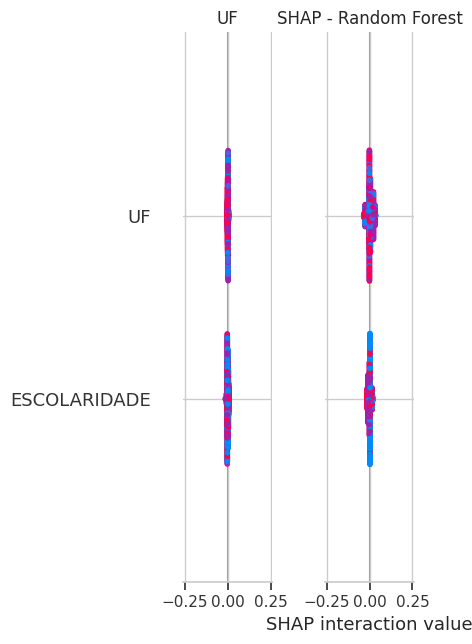

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.0252 ± 0.0040,TEMPO_ULTIMO_EMPREGO_MESES
0.0020 ± 0.0007,VL_IMOVEIS
0 ± 0.0000,VALOR_TABELA_CARROS
0 ± 0.0000,QT_CARROS
0 ± 0.0000,ULTIMO_SALARIO
0 ± 0.0000,TRABALHANDO_ATUALMENTE
0 ± 0.0000,FAIXA_ETARIA
0 ± 0.0000,OUTRA_RENDA_VALOR
0 ± 0.0000,OUTRA_RENDA
0 ± 0.0000,QT_IMOVEIS


Gerando Anchor (regra) ...
Anchor rules: ['ESCOLARIDADE > 1.00', 'VL_IMOVEIS <= 185000.00', 'CASA_PROPRIA <= 0.00']
Precision: 1.000, Coverage: 0.120

--- Modelo: Logistic Regression ---
Gerando SHAP (resumido / barra)...


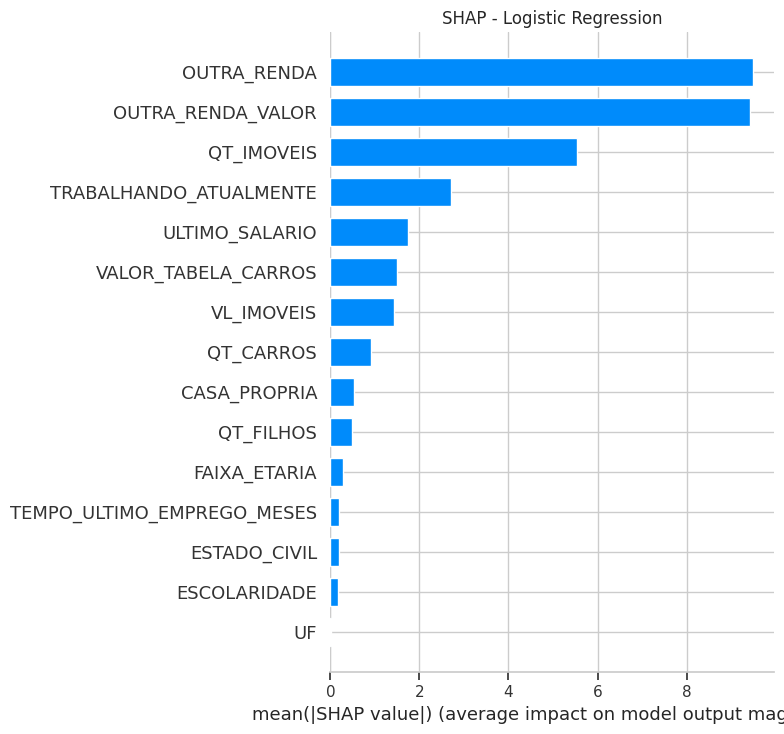

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.2957 ± 0.0186,QT_IMOVEIS
0.1847 ± 0.0150,OUTRA_RENDA_VALOR
0.1231 ± 0.0048,TRABALHANDO_ATUALMENTE
0.1206 ± 0.0141,OUTRA_RENDA
0.1105 ± 0.0069,ULTIMO_SALARIO
0.0649 ± 0.0077,VALOR_TABELA_CARROS
0.0623 ± 0.0098,QT_CARROS
0.0462 ± 0.0060,VL_IMOVEIS
0.0366 ± 0.0032,CASA_PROPRIA
0.0205 ± 0.0033,TEMPO_ULTIMO_EMPREGO_MESES


Gerando Anchor (regra) ...
Anchor rules: ['QT_IMOVEIS <= 0.00']
Precision: 0.954, Coverage: 0.450

--- Modelo: XGBoost ---
Gerando SHAP (resumido / barra)...


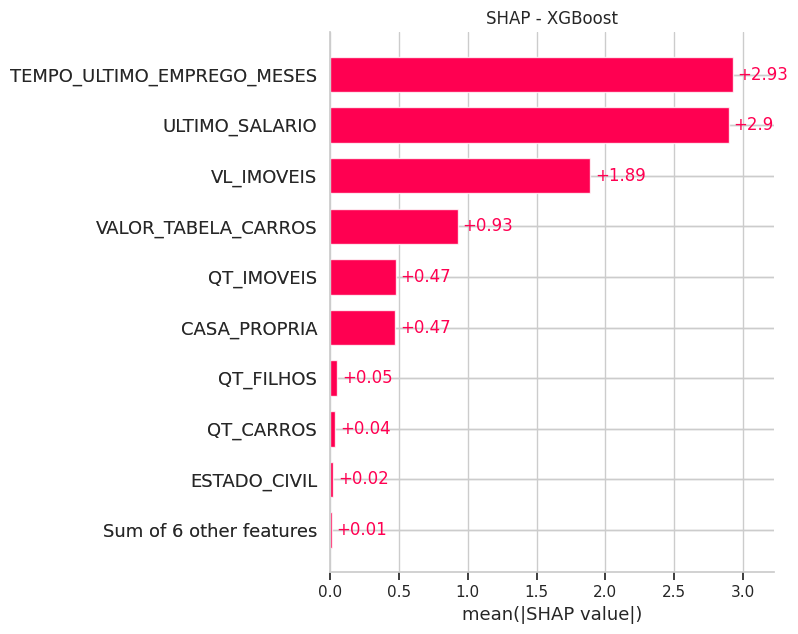

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.2054 ± 0.0150,TEMPO_ULTIMO_EMPREGO_MESES
0.1455 ± 0.0060,ULTIMO_SALARIO
0.0491 ± 0.0045,QT_IMOVEIS
0 ± 0.0000,QT_CARROS
0 ± 0.0000,VALOR_TABELA_CARROS
0 ± 0.0000,TRABALHANDO_ATUALMENTE
0 ± 0.0000,FAIXA_ETARIA
0 ± 0.0000,OUTRA_RENDA_VALOR
0 ± 0.0000,OUTRA_RENDA
0 ± 0.0000,VL_IMOVEIS


Gerando Anchor (regra) ...
Anchor rules: ['QT_IMOVEIS <= 0.00', 'VL_IMOVEIS <= 185000.00', 'ULTIMO_SALARIO > 6100.00']
Precision: 1.000, Coverage: 0.048

--- Modelo: Decision Tree ---
Gerando SHAP (resumido / barra)...


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

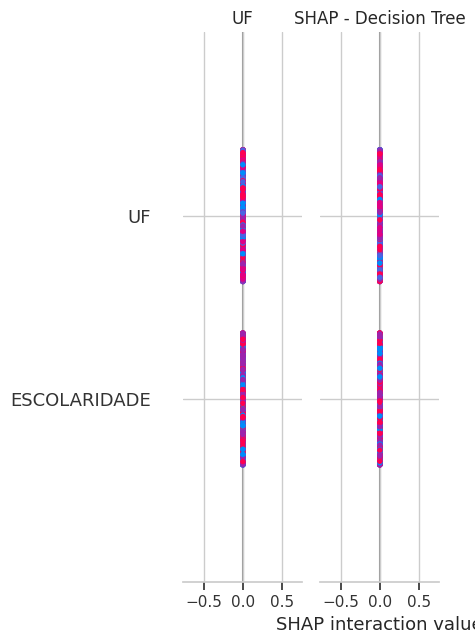

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.3069 ± 0.0083,TEMPO_ULTIMO_EMPREGO_MESES
0.1419 ± 0.0091,VL_IMOVEIS
0.1030 ± 0.0044,ULTIMO_SALARIO
0.0479 ± 0.0044,QT_CARROS
0 ± 0.0000,VALOR_TABELA_CARROS
0 ± 0.0000,TRABALHANDO_ATUALMENTE
0 ± 0.0000,FAIXA_ETARIA
0 ± 0.0000,OUTRA_RENDA_VALOR
0 ± 0.0000,OUTRA_RENDA
0 ± 0.0000,QT_IMOVEIS


Gerando Anchor (regra) ...
Anchor rules: ['VL_IMOVEIS <= 370000.00', 'QT_IMOVEIS <= 0.00', 'CASA_PROPRIA <= 0.00']
Precision: 1.000, Coverage: 0.323

--- Modelo: MLP ---
Gerando SHAP (resumido / barra)...


  0%|          | 0/100 [00:00<?, ?it/s]

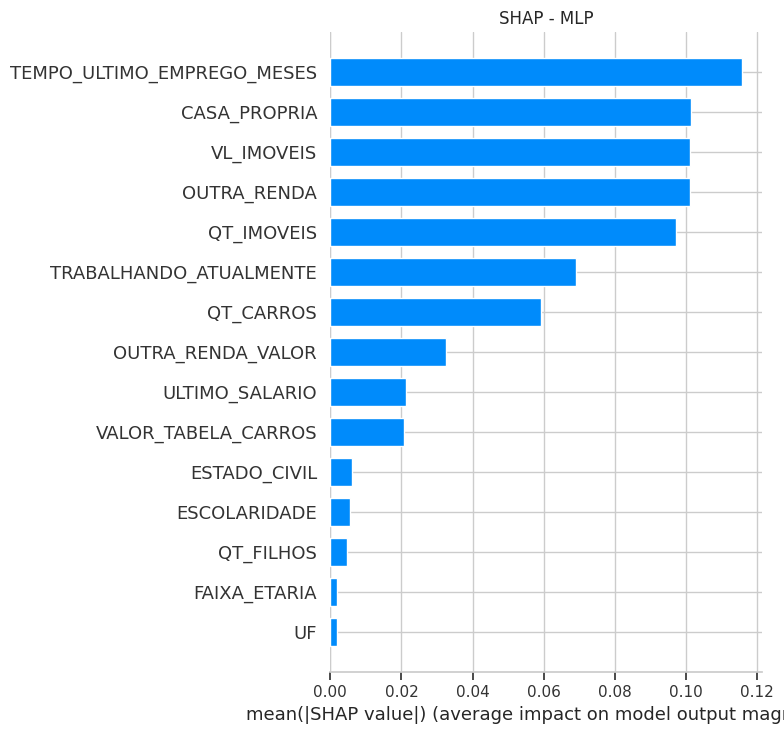

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.1048 ± 0.0101,OUTRA_RENDA
0.1040 ± 0.0072,CASA_PROPRIA
0.0950 ± 0.0058,QT_IMOVEIS
0.0886 ± 0.0061,TEMPO_ULTIMO_EMPREGO_MESES
0.0676 ± 0.0056,QT_CARROS
0.0663 ± 0.0055,VL_IMOVEIS
0.0580 ± 0.0050,TRABALHANDO_ATUALMENTE
0.0092 ± 0.0017,VALOR_TABELA_CARROS
0.0053 ± 0.0015,ULTIMO_SALARIO
0.0041 ± 0.0022,ESCOLARIDADE


Gerando Anchor (regra) ...
Anchor rules: ['CASA_PROPRIA <= 0.00', 'QT_IMOVEIS <= 0.00']
Precision: 1.000, Coverage: 0.324

--- Modelo: Naive Bayes ---
Gerando SHAP (resumido / barra)...


  0%|          | 0/100 [00:00<?, ?it/s]

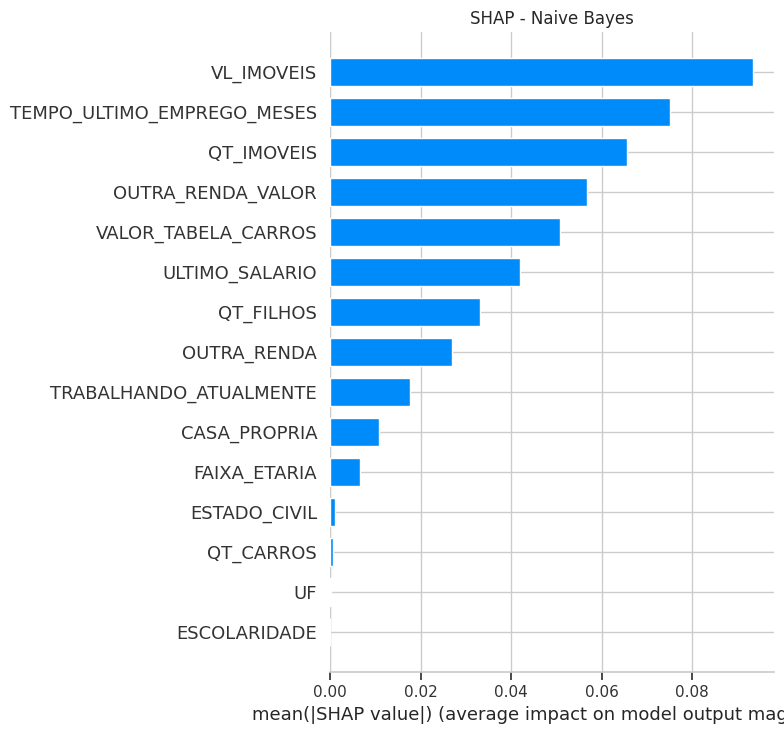

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.0733 ± 0.0092,VL_IMOVEIS
0.0393 ± 0.0106,QT_IMOVEIS
0.0363 ± 0.0073,TEMPO_ULTIMO_EMPREGO_MESES
0.0198 ± 0.0067,QT_FILHOS
0.0178 ± 0.0052,VALOR_TABELA_CARROS
0.0131 ± 0.0051,OUTRA_RENDA_VALOR
0.0104 ± 0.0052,ULTIMO_SALARIO
0.0067 ± 0.0025,TRABALHANDO_ATUALMENTE
0.0035 ± 0.0018,QT_CARROS
0.0031 ± 0.0010,UF


Gerando Anchor (regra) ...
Anchor rules: ['VL_IMOVEIS <= 185000.00', 'QT_IMOVEIS <= 0.00']
Precision: 0.988, Coverage: 0.448

--- Modelo: KNN ---
Gerando SHAP (resumido / barra)...


  0%|          | 0/100 [00:00<?, ?it/s]

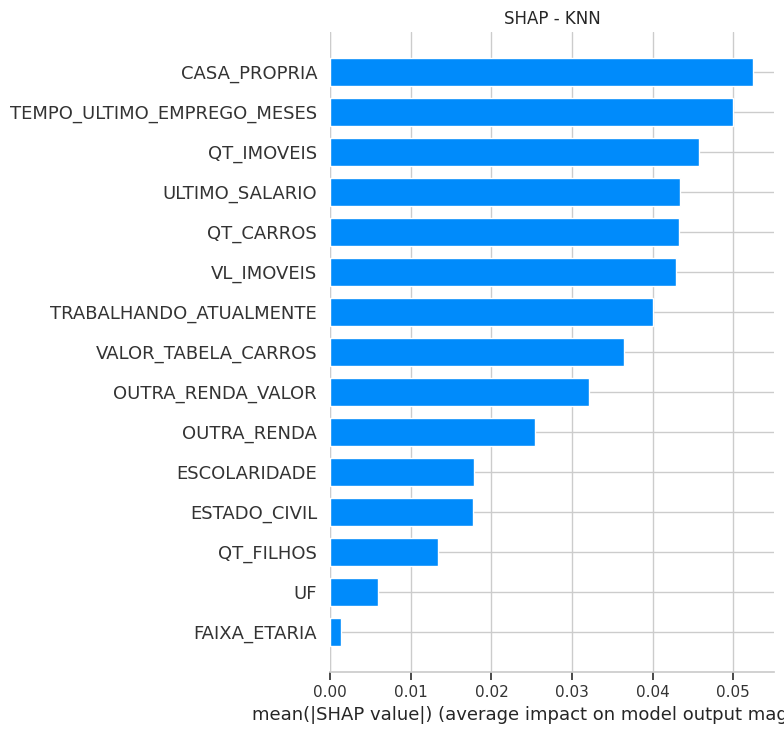

Gerando LIME (local) ...


Gerando ELI5 (Permutation Importance) ...


Weight,Feature
0.0483 ± 0.0036,CASA_PROPRIA
0.0368 ± 0.0035,QT_CARROS
0.0168 ± 0.0060,ULTIMO_SALARIO
0.0061 ± 0.0035,QT_IMOVEIS
0.0060 ± 0.0019,TEMPO_ULTIMO_EMPREGO_MESES
0.0057 ± 0.0016,ESCOLARIDADE
0.0056 ± 0.0032,VALOR_TABELA_CARROS
0.0056 ± 0.0013,ESTADO_CIVIL
0.0053 ± 0.0039,VL_IMOVEIS
0.0011 ± 0.0011,UF


Gerando Anchor (regra) ...
Anchor rules: ['CASA_PROPRIA <= 0.00', 'VL_IMOVEIS <= 185000.00', 'QT_CARROS <= 1.00']
Precision: 1.000, Coverage: 0.197


<Figure size 1200x600 with 0 Axes>

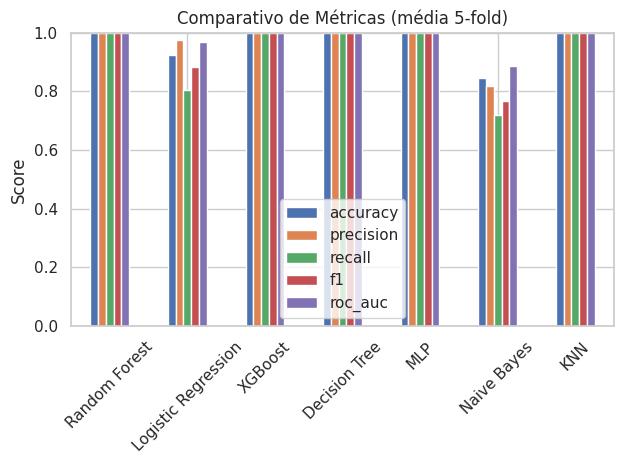


Calculando MEMC para cada modelo...


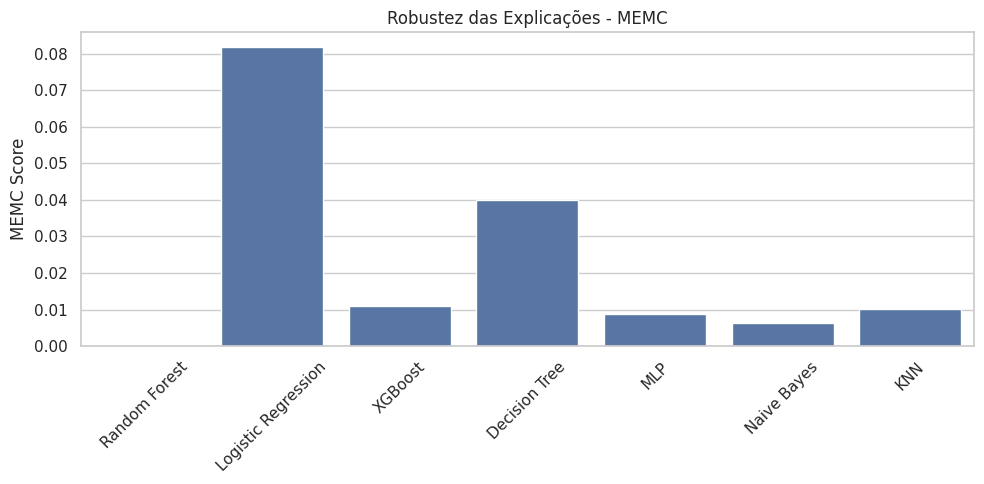


✔ Pipeline concluído.


In [ ]:
# -*- coding: utf-8 -*-
"""
Pipeline refatorado para avaliação e explicabilidade de múltiplos modelos
(com cross-validation, SHAP, LIME, ELI5, ANCHOR e cálculo MEMC).

Corrige o NameError (StratifiedKFold não importado) e várias inconsistências:
- Separa a etapa de validação (5-fold CV) da etapa de explicabilidade (treina o modelo
  final em X_train_scaled antes de gerar explicações sobre X_test_scaled).
- Usa predict_proba para cálculo de ROC AUC (em vez de rótulos).
- Garante funções de predição que aceitam dados no domínio ORIGINAL (para LIME/ANCHOR)
  e no domínio ESCALADO (para SHAP/ELI5/PERMUTATION).
- Tratamento robusto de SHAP para versões antigas/novas da API.
- Anchor classifier retorna rótulos 1D para evitar erro de np.hstack.

Pré-requisitos:
    pip install shap lime eli5 anchor-exp xgboost

Variáveis esperadas no ambiente antes de executar:
    X_train, X_test: pd.DataFrame (dados originais, sem escala)
    y_train, y_test: pd.Series
    scaler: objeto (fit no X_train) usado para gerar X_train_scaled/X_test_scaled
    X_train_scaled, X_test_scaled: pd.DataFrame (mesmas colunas que X_train)

Adaptar nomes se necessário.
"""

import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

import shap
import lime.lime_tabular
import eli5
from eli5.sklearn import PermutationImportance
from anchor import anchor_tabular

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier

sns.set_theme(style='whitegrid')
np.random.seed(42)

# -------------------------------
# Utilitários
# -------------------------------

def _ensure_numpy_2d(X):
    if isinstance(X, pd.DataFrame):
        return X.values
    X = np.array(X)
    if X.ndim == 1:
        X = X.reshape(1, -1)
    return X


def _ensure_numpy_1d_row(x):
    if isinstance(x, pd.DataFrame):
        arr = x.values
        if arr.ndim == 2 and arr.shape[0] == 1:
            return arr[0]
        raise ValueError('Esperado DataFrame com uma única linha para converter em 1D.')
    if isinstance(x, pd.Series):
        return x.values
    arr = np.array(x)
    if arr.ndim == 2 and arr.shape[0] == 1:
        return arr[0]
    if arr.ndim == 1:
        return arr
    raise ValueError('Esperado vetor 1D ou matriz com uma linha.')


# -------------------------------
# Verificações mínimas
# -------------------------------
required_vars = ['X_train', 'X_test', 'y_train', 'y_test', 'scaler', 'X_train_scaled', 'X_test_scaled']
for v in required_vars:
    if v not in globals():
        raise RuntimeError(f"Variável obrigatória não encontrada no ambiente: {v}")

# Atalho para nomes de features
feature_names = list(X_train.columns)

# -------------------------------
# 1) Modelos (definição)
# -------------------------------
models = {
    'Random Forest': RandomForestClassifier(random_state=42),
    'Logistic Regression': LogisticRegression(max_iter=1000, random_state=42),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'MLP': MLPClassifier(hidden_layer_sizes=(50, 30), max_iter=1000, random_state=42),
    'Naive Bayes': GaussianNB(),
    'KNN': KNeighborsClassifier(n_neighbors=5)
}

# -------------------------------
# 2) Cross-validation (apenas métricas)
# -------------------------------
results = {}
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

print('\n=== Avaliação 5-Fold (métricas médias) ===')
for name, model in models.items():
    accs, precs, recs, f1s, aucs = [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train_scaled, y_train):
        X_t = X_train_scaled.iloc[train_idx]
        X_v = X_train_scaled.iloc[val_idx]
        y_t = y_train.iloc[train_idx]
        y_v = y_train.iloc[val_idx]

        model.fit(X_t, y_t)
        y_pred = model.predict(X_v)
        # Para AUC, utilize probabilidades da classe positiva
        try:
            y_proba = model.predict_proba(X_v)[:, 1]
            aucs.append(roc_auc_score(y_v, y_proba))
        except Exception:
            # fallback se modelo não suportar predict_proba
            try:
                aucs.append(roc_auc_score(y_v, model.predict(X_v)))
            except Exception:
                aucs.append(np.nan)

        accs.append(accuracy_score(y_v, y_pred))
        precs.append(precision_score(y_v, y_pred, zero_division=0))
        recs.append(recall_score(y_v, y_pred, zero_division=0))
        f1s.append(f1_score(y_v, y_pred, zero_division=0))

    results[name] = {
        'accuracy': np.nanmean(accs),
        'precision': np.nanmean(precs),
        'recall': np.nanmean(recs),
        'f1': np.nanmean(f1s),
        'roc_auc': np.nanmean(aucs)
    }

    print(f"\n{name} - Média 5-Fold:")
    print(f"Accuracy: {results[name]['accuracy']:.4f}, Precision: {results[name]['precision']:.4f}, "
          f"Recall: {results[name]['recall']:.4f}, F1: {results[name]['f1']:.4f}, ROC AUC: {results[name]['roc_auc']:.4f}")

# -------------------------------
# 3) Explicabilidade (treina modelo final em todo X_train_scaled e explica X_test_scaled)
# -------------------------------

# Seleciona uma instância para explicação local (prioriza classe 0 = 'Recusado')
try:
    mask_recusado = (np.array(y_test) == 0)
    if mask_recusado.any():
        idx_local = X_test_scaled.index[mask_recusado][0]
    else:
        idx_local = X_test_scaled.index[0]
except Exception:
    idx_local = X_test_scaled.index[0]

x_row_scaled_df = X_test_scaled.loc[[idx_local]]
x_row_scaled_1d = _ensure_numpy_1d_row(x_row_scaled_df)
# versão original (não escalada) para LIME / ANCHOR
x_row_orig_arr = scaler.inverse_transform(_ensure_numpy_2d(x_row_scaled_df))
x_row_orig_1d = x_row_orig_arr[0]

print('\n=== Explicações locais/globais (SHAP, LIME, ELI5, ANCHOR) ===')

for name, model in models.items():
    print(f"\n--- Modelo: {name} ---")

    # Treina modelo final em todo X_train_scaled
    model.fit(X_train_scaled, y_train)

    # ---------------------------------
    # SHAP
    # ---------------------------------
    print('Gerando SHAP (resumido / barra)...')
    try:
        # Tree models -> TreeExplainer (mais eficiente)
        if name in ['Random Forest', 'XGBoost', 'Decision Tree']:
            expl = shap.TreeExplainer(model)
            try:
                shap_values = expl(X_test_scaled)
                plt.figure(); shap.plots.bar(shap_values, show=False); plt.title(f'SHAP - {name}'); plt.tight_layout(); plt.show()
            except Exception:
                # Fallback para API mais antiga
                shap_values = expl.shap_values(X_test_scaled)
                plt.figure(); shap.summary_plot(shap_values, X_test_scaled, plot_type='bar', show=False); plt.title(f'SHAP - {name}'); plt.tight_layout(); plt.show()

        elif name == 'Logistic Regression':
            expl = shap.LinearExplainer(model, X_train_scaled, feature_perturbation='interventional')
            try:
                shap_values = expl.shap_values(X_test_scaled)
                plt.figure(); shap.summary_plot(shap_values, X_test_scaled, plot_type='bar', show=False); plt.title(f'SHAP - {name}'); plt.tight_layout(); plt.show()
            except Exception:
                shap_values = expl(X_test_scaled)
                plt.figure(); shap.plots.bar(shap_values, show=False); plt.title(f'SHAP - {name}'); plt.tight_layout(); plt.show()

        else:
            # Modelos não-árvore: usar KernelExplainer (com background amostrado para desempenho)
            background = _ensure_numpy_2d(X_train_scaled.sample(n=min(100, len(X_train_scaled)), random_state=42))
            # KernelExplainer espera uma função que retorne output (probabilidade da classe positiva)
            f = lambda z: model.predict_proba(z)[:, 1]
            expl = shap.KernelExplainer(f, background)
            shap_values = expl.shap_values(_ensure_numpy_2d(X_test_scaled.sample(n=min(100, len(X_test_scaled)), random_state=42)))
            # shap_values pode ser uma lista (multi-output)
            try:
                plt.figure(); shap.summary_plot(shap_values, X_test_scaled, plot_type='bar', show=False); plt.title(f'SHAP - {name}'); plt.tight_layout(); plt.show()
            except Exception:
                # em último caso, apenas passe
                pass
    except Exception as e:
        print(f'[AVISO] SHAP falhou para {name}: {e}')

    # ---------------------------------
    # LIME
    # ---------------------------------
    print('Gerando LIME (local) ...')
    try:
        # LIME: usamos os dados ORIGINAIS (não escalados) como referência para perturbações
        X_train_orig = scaler.inverse_transform(_ensure_numpy_2d(X_train_scaled))
        lime_expl = lime.lime_tabular.LimeTabularExplainer(
            training_data=_ensure_numpy_2d(X_train_orig),
            feature_names=feature_names,
            class_names=['Recusado', 'Aprovado'],
            mode='classification'
        )
        # explain_instance espera a linha em domínio ORIGINAL
        exp = lime_expl.explain_instance(x_row_orig_1d, lambda z: model.predict_proba(scaler.transform(_ensure_numpy_2d(z))), num_features=min(8, len(feature_names)))
        try:
            exp.show_in_notebook(show_table=True)
        except Exception:
            print('LIME (top contribuições):', exp.as_list())
    except Exception as e:
        print(f'[AVISO] LIME falhou em {name}: {e}')

    # ---------------------------------
    # ELI5 (Permutation Importance)
    # ---------------------------------
    print('Gerando ELI5 (Permutation Importance) ...')
    try:
        perm = PermutationImportance(model, random_state=42).fit(_ensure_numpy_2d(X_test_scaled), y_test)
        display(eli5.show_weights(perm, feature_names=feature_names))
    except Exception as e:
        print(f'[AVISO] ELI5 falhou em {name}: {e}')

    # ---------------------------------
    # ANCHOR
    # ---------------------------------
    print('Gerando Anchor (regra) ...')
    try:
        anchor_explainer = anchor_tabular.AnchorTabularExplainer(
            class_names=['Recusado', 'Aprovado'],
            feature_names=feature_names,
            train_data=_ensure_numpy_2d(X_train)
        )

        # classifier_fn deve aceitar dados no DOMÍNIO ORIGINAL e retornar rótulos 1D
        def anchor_classifier(z):
            z_arr = _ensure_numpy_2d(z)
            z_scaled = scaler.transform(z_arr)
            preds = model.predict(z_scaled)
            return np.ravel(preds)

        anchor_exp = anchor_explainer.explain_instance(x_row_orig_1d, anchor_classifier, threshold=0.95)
        print('Anchor rules:', anchor_exp.names())
        try:
            print(f'Precision: {anchor_exp.precision():.3f}, Coverage: {anchor_exp.coverage():.3f}')
        except Exception:
            pass
    except Exception as e:
        print(f'[AVISO] Anchor falhou em {name}: {e}')

# -------------------------------
# 4) Plot comparativo de métricas
# -------------------------------
metrics_df = pd.DataFrame(results).T
plt.figure(figsize=(12, 6))
metrics_df.plot(kind='bar', ylim=(0, 1), title='Comparativo de Métricas (média 5-fold)')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.tight_layout(); plt.show()

# -------------------------------
# 5) MEMC (Robustez das explicações)
# -------------------------------
print('\nCalculando MEMC para cada modelo...')
memc_scores = {}
for name, model in models.items():
    try:
        model.fit(X_train_scaled, y_train)
        try:
            baseline_proba = model.predict_proba(X_test_scaled)[:, 1]
            baseline_auc = roc_auc_score(y_test, baseline_proba)
        except Exception:
            baseline_auc = roc_auc_score(y_test, model.predict(X_test_scaled))

        changes = []
        for col in X_test_scaled.columns:
            X_pert = X_test_scaled.copy()
            X_pert[col] = np.random.permutation(X_pert[col].values)
            try:
                pert_proba = model.predict_proba(X_pert)[:, 1]
                pert_auc = roc_auc_score(y_test, pert_proba)
            except Exception:
                pert_auc = roc_auc_score(y_test, model.predict(X_pert))
            changes.append(abs(baseline_auc - pert_auc))
        memc_scores[name] = np.mean(changes)
    except Exception as e:
        memc_scores[name] = np.nan
        print(f'[AVISO] MEMC falhou para {name}: {e}')

plt.figure(figsize=(10, 5))
sns.barplot(x=list(memc_scores.keys()), y=list(memc_scores.values()))
plt.xticks(rotation=45); plt.ylabel('MEMC Score'); plt.title('Robustez das Explicações - MEMC'); plt.tight_layout(); plt.show()

print('\n✔ Pipeline concluído.')


In [ ]:
memc = {}
for metric in ["accuracy", "precision", "recall", "f1"]:
    values = [results[model][metric] for model in results]
    mean_value = np.mean(values)
    memc[metric] = mean_value

print("\n==== Mean Evaluation of Metrics Change (MEMC) ====")
for metric, val in memc.items():
    print(f"{metric.capitalize()}: {val:.4f}")


==== Mean Evaluation of Metrics Change (MEMC) ====
Accuracy: 0.9674
Precision: 0.9709
Recall: 0.9320
F1: 0.9498


# **Avaliação do XAI em uma única instância ( ùnico cliente ) para o modelo XGBoost**

In [ ]:
# A primeira coisa que temos que fazer é importar os pacotes que iremos utilizar.
# Obs.: Pacotes do Python são conjuntos de funcionalidades disponíveis da ferramenta.

#Pandas: Possui inúmeras funções e comandos para importar arquivos, analisar dados, tratar dados, etc.
import pandas as pd

#Matplotlib: Possui uma série de funções e comandos para exibição de gráficos
import matplotlib.pyplot as plt

#Seaborn: Possui uma série de funções e comandos para exibição de gráficos (Visualizações mais robustas do que o Matplotlib)
import seaborn as sns

#Numpy: Possui uma série de funções e comandos para trabalharmos com números de forma em geral(formatação, calculos, etc)
import numpy as np

#Warnings: Possui detalhes sobre os avisos e alertas que aparecem, porém podemos utiliza-lo também para que os alertas de
#futuras atualizações e metodos depreciados não sejam exibidos
import warnings
warnings.filterwarnings("ignore")


from sklearn.model_selection import train_test_split # Utilizado para separar dados de treino e teste
from sklearn.preprocessing import StandardScaler # Utilizado para fazer a normalização dos dados
from sklearn.preprocessing import MinMaxScaler # Utilizado para fazer a normalização dos dados
from sklearn.preprocessing import LabelEncoder # Utilizado para fazer o OneHotEncoding
from sklearn.linear_model import LinearRegression # Algoritmo de Regressão Linear
from sklearn.metrics import r2_score # Utilizado para medir a acuracia do modelo preditivo
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix # Import necessary metrics
from sklearn.ensemble import RandomForestClassifier  # Import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from IPython.display import display, HTML


# CREDIT RISK CLASSIFICATION WITH XAI TECHNIQUES

import shap
import lime.lime_tabular
import eli5
from eli5.sklearn import PermutationImportance
from anchor import anchor_tabular

import warnings
warnings.filterwarnings('ignore')

import os

#Comando para exibir todas colunas do arquivo
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

import pickle

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
model_instance = {"XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)}
name = "XGBoost"

# **Prevendo se o cliente será Aprovando o seu crédito e salvando os arquivos para aplicar o XAI e avaliação local.**

In [ ]:
import pickle
# Dados do cliente
novos_dados = [2, 0, 0, 1, 1, 1, 50000, 0, 0, 18, 1, 2300.0, 1, 30000, 2]
X_input = np.array(novos_dados).reshape(1, -1)
X_scaled = scaler.transform(X_input)

# Get the Logistic Regression model (assuming it was trained previously)
model_instance = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42) # Re-initialize if needed
model_instance.fit(X_train_scaled, y_train) # Fit the model

# Previsão
score_predito = model_instance.predict(X_scaled)
print(f"Score de crédito previsto para esse cliente: {score_predito}")

# Salving the X
file_path_X = '/content/drive/MyDrive/Colab Notebooks/TCC/X.pkl'
pickle.dump(X, open(file_path_X, 'wb'))

# Salving the y
file_path_y = '/content/drive/MyDrive/Colab Notebooks/TCC/y.pkl'
pickle.dump(y_test, open(file_path_y, 'wb'))

# Salving the X_train
file_path_X_train = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train.pkl'
pickle.dump(X_train, open(file_path_X_train, 'wb'))

# Salving the X_train
file_path_X_test = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test.pkl'
pickle.dump(X_test, open(file_path_X_test, 'wb'))

# Salving the X_train_scaled
file_path_X_train_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train_scaled.pkl'
pickle.dump(X_train_scaled, open(file_path_X_train_scaled, 'wb'))

# Salving the X_test_scaled
file_path_X_test_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test_scaled.pkl'
pickle.dump(X_test_scaled, open(file_path_X_test_scaled, 'wb'))

# Salving the scaler
file_path_scaler = '/content/drive/MyDrive/Colab Notebooks/TCC/scaler.pkl'
pickle.dump(scaler, open(file_path_scaler, 'wb'))

# Salvando o modelo de regressão linear
file_path_model = '/content/drive/MyDrive/Colab Notebooks/TCC/modelo_regressao.pkl'
pickle.dump(model_instance, open(file_path_model, 'wb'))

Score de crédito previsto para esse cliente: [0]


Leitura

In [ ]:
# loading the X
file_path_X = '/content/drive/MyDrive/Colab Notebooks/TCC/X.pkl'
X = pickle.load(open(file_path_X, 'rb'))

# loading the y
file_path_y = '/content/drive/MyDrive/Colab Notebooks/TCC/y.pkl'
y = pickle.load(open(file_path_y, 'rb'))

# loading the X_train
file_path_X_train = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train.pkl'
X_train = pickle.load(open(file_path_X_train, 'rb'))

# loading the X_test
file_path_X_test = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test.pkl'
X_test = pickle.load(open(file_path_X_test, 'rb'))

# loading the X_train_scaled
file_path_X_train_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train_scaled.pkl'
X_train_scaled = pickle.load(open(file_path_X_train_scaled, 'rb'))
# loading the X_test_scaled
file_path_X_test_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test_scaled.pkl'
X_test_scaled = pickle.load(open(file_path_X_test_scaled, 'rb'))
# loading the saved model
lr_model = pickle.load(open('/content/drive/MyDrive/Colab Notebooks/TCC/modelo_regressao.pkl', 'rb'))
# Make sure to load the correct scaler file, updating the path or the variable assignment as needed.
scaler = pickle.load(open('/content/drive/MyDrive/Colab Notebooks/TCC/scaler.pkl', 'rb')) # Updated to load the scaler

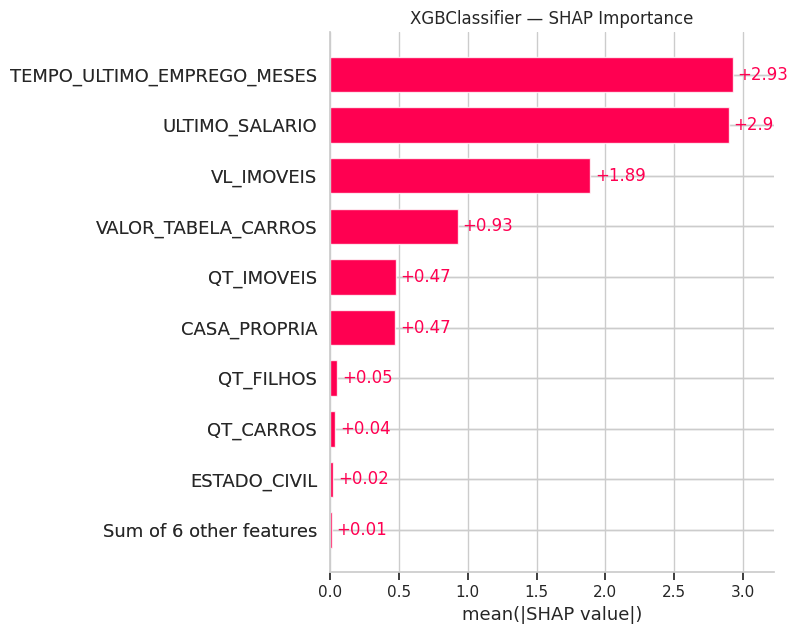

In [ ]:
# -*- coding: utf-8 -*-
"""
Análise e explicabilidade local -- versão refatorada e robusta
Espera-se que o ambiente contenha as variáveis:
  - X_train, X_test (DataFrame, ORIGINAIS)
  - X_train_scaled, X_test_scaled (DataFrame, ESCALADOS com o mesmo order/cols)
  - y_train, y_test (Series)
  - scaler (objeto com transform/ inverse_transform)
  - um modelo treinado disponível em uma das variáveis: lr_model, model_instance, tuned_model, model

O script faz:
  - Previsão de uma instância (novos_dados)
  - SHAP local (para modelos compatíveis) e gráfico resumo global (se X_test_scaled estiver disponível)
  - LIME (usa dados originais para perturbações e uma predict_fn que aplica scaler internamente)
  - ELI5 (explain_prediction / show_prediction)
  - Anchor (usa os dados originais; classifier retorna rótulos 1D)

Principais correções realizadas:
  - corrige o NameError de variável indefinida (feature_names_list)
  - unifica qual modelo usar (busca por lr_model, model_instance, tuned_model, model)
  - extrai corretamente os valores SHAP de diferentes formatos (novo/antigo API)
  - garante que o Anchor receba classifier_fn que retorna rótulos 1D
  - mensagens e displays claros para notebook

Observação: o modelo precisa estar treinado. Se não estiver, carregue via joblib/pickle ou treine antes.

"""

import numpy as np
import pandas as pd
import shap
import lime.lime_tabular
import eli5
from eli5.sklearn import PermutationImportance
from anchor import anchor_tabular
from IPython.display import display, HTML
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(style='whitegrid')

# -------------------------------
# Helpers
# -------------------------------

def _ensure_numpy_2d(X):
    if isinstance(X, pd.DataFrame):
        return X.values
    arr = np.array(X)
    if arr.ndim == 1:
        arr = arr.reshape(1, -1)
    return arr


def _ensure_numpy_1d(x):
    if isinstance(x, pd.DataFrame):
        arr = x.values
        if arr.ndim == 2 and arr.shape[0] == 1:
            return arr[0]
        raise ValueError('Esperado DataFrame com exatamente 1 linha para converter em 1D')
    if isinstance(x, pd.Series):
        return x.values
    arr = np.array(x)
    if arr.ndim == 2 and arr.shape[0] == 1:
        return arr[0]
    if arr.ndim == 1:
        return arr
    raise ValueError('Esperado vetor 1D ou matriz com uma linha.')


def _extract_shap_values(obj):
    """Retorna um numpy array (n_samples, n_features) a partir de diferentes formatos que SHAP pode devolver."""
    # lista -> escolher última (classe positiva) ou primeiro elemento útil
    if isinstance(obj, list):
        # frequentemente shap.KernelExplainer retorna lista por classe
        arr = obj[-1]
        if hasattr(arr, 'values'):
            return np.asarray(arr.values)
        return np.asarray(arr)
    # shap.Explanation
    if hasattr(obj, 'values'):
        return np.asarray(obj.values)
    # numpy array
    return np.asarray(obj)


# -------------------------------
# Verificações mínimas (variáveis no ambiente)
# -------------------------------
required = ['scaler']
missing = [v for v in required if v not in globals()]
if missing:
    raise RuntimeError(f"Variáveis obrigatórias ausentes no ambiente: {missing}. Carregue o scaler e os dados antes.")

# tentativas de identificar X_train / X_test / y_train / X_train_scaled / X_test_scaled
X_train = globals().get('X_train', None)
X_test = globals().get('X_test', None)
X_train_scaled = globals().get('X_train_scaled', None)
X_test_scaled = globals().get('X_test_scaled', None)
y_train = globals().get('y_train', None)
y_test = globals().get('y_test', None)

# Feature names: prioriza X_train, senão X_train_scaled
if X_train is not None:
    feature_names = list(X_train.columns)
elif X_train_scaled is not None:
    feature_names = list(X_train_scaled.columns)
else:
    raise RuntimeError("Não foi possível identificar nomes de features: forneça X_train ou X_train_scaled no ambiente.")

# Class names (se y_train disponível, tenta mapear 0/1 -> Reprovado/Aprovado)
if y_train is not None:
    uniq = sorted(pd.Series(y_train).unique())
    if set(uniq) == {0, 1}:
        class_names = ['Reprovado', 'Aprovado']
    else:
        class_names = [str(u) for u in uniq]
else:
    class_names = ['Neg', 'Pos']

# Tenta identificar o modelo treinado em variáveis comuns
_model_candidates = ['lr_model', 'model_instance', 'tuned_model', 'tuned_xgb_estimator', 'model', 'clf']
model = None
for cname in _model_candidates:
    if cname in globals():
        model = globals()[cname]
        model_varname = cname
        break
if model is None:
    raise RuntimeError(
        "Modelo treinado não encontrado no ambiente. Defina 'lr_model' ou 'model_instance' (ou carregue via joblib) antes de executar este script."
    )

model_cls_name = model.__class__.__name__

# -------------------------------
# 1) Entrada do cliente
# -------------------------------

display(HTML("<h2>🚀 Análise de Explicabilidade Local para um Cliente Específico</h2>"))

novos_dados = [2, 0, 0, 1, 1, 1, 50000, 0, 0, 18, 1, 2300.0, 1, 30000, 2]
X_input = np.array(novos_dados).reshape(1, -1)

# escala
X_scaled = scaler.transform(X_input)
X_scaled_df = pd.DataFrame(X_scaled, columns=feature_names)

# Previsão (garantindo escalar/shape correto)
pred_raw = model.predict(X_scaled)
pred_val = int(np.ravel(pred_raw)[0])
mensagem = 'Aprovado' if pred_val == 1 else 'Reprovado'
cor = 'green' if pred_val == 1 else 'red'
display(HTML(f"<b><span style='color:{cor}'>{mensagem}</span></b>"))

# -------------------------------
# 2) SHAP (local para a instância + resumo global opcional)
# -------------------------------

display(HTML('<h3>📊 SHAP — explicação local (instância)</h3>'))
if model_cls_name in ('RandomForestClassifier', 'XGBClassifier', 'DecisionTreeClassifier', 'GradientBoostingClassifier') or model_cls_name == 'LogisticRegression':
    try:
        # escolhe explainer adequado
        if model_cls_name == 'LogisticRegression':
            expl = shap.LinearExplainer(model, X_train_scaled if X_train_scaled is not None else _ensure_numpy_2d(X_train))
            shap_res = expl(X_scaled_df)
        else:
            expl = shap.TreeExplainer(model)
            shap_res = expl(X_scaled_df)

        shap_array = _extract_shap_values(shap_res)  # (n_samples, n_features)
        contribs = shap_array[0]

        # nomes das features
        feature_names_list = feature_names

        # obtem top 3 negativos (maiores contribuições negativas)
        top_negatives = np.argsort(contribs)[:3]
        razoes = [feature_names_list[i] for i in top_negatives]

        display(HTML(f"<b>Principais fatores negativos (SHAP — instância): {', '.join(razoes)}</b>"))

        # plot summary global se X_test_scaled disponível
        if X_test_scaled is not None:
            try:
                shap_all = expl(X_test_scaled)
                plt.figure(); shap.plots.bar(shap_all, show=False); plt.title(f"{model_cls_name} — SHAP Importance"); plt.tight_layout(); plt.show()


            except Exception:
                try:
                    shap_vals_all = expl.shap_values(X_test_scaled)
                    plt.figure(); shap.summary_plot(shap_vals_all, X_test_scaled, plot_type='bar', show=False); plt.title(f"{model_cls_name} — SHAP Importance"); plt.tight_layout(); plt.show()
                except Exception:
                    pass


    except Exception as e:
        display(HTML(f"<b style='color:orange'>[AVISO] SHAP falhou: {e}</b>"))
else:
    display(HTML(f"<b>SHAP ignorado para modelo {model_cls_name} (compatibilidade).</b>"))

# -------------------------------
# 3) LIME (local)
# -------------------------------

display(HTML('<h3>🧠 LIME — explicação local</h3>'))
try:
    if X_train is None:
        raise RuntimeError('X_train original (não escalado) necessário para LIME.')
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=_ensure_numpy_2d(X_train),
        feature_names=feature_names,
        class_names=class_names,
        mode='classification'
    )

    # LIME espera dados no domínio original; predict_fn recebe dados originais e aplica scaler
    predict_fn = lambda z: model.predict_proba(scaler.transform(_ensure_numpy_2d(z)))
    lime_exp = lime_explainer.explain_instance(X_input[0], predict_fn, num_features=min(8, len(feature_names)))
    try:
        lime_exp.show_in_notebook(show_table=True)
    except Exception:
        display(HTML('<b>LIME (top contribuições):</b>'))
        for f, w in lime_exp.as_list():
            display(HTML(f"<b>{f}</b>: {w:.4f}"))
except Exception as e:
    display(HTML(f"<b style='color:orange'>[AVISO] LIME falhou: {e}</b>"))

# -------------------------------
# 4) ELI5 (prediction explain)
# -------------------------------

display(HTML('<h3>🔍 ELI5 — explicação local</h3>'))
try:
    feature_names_list = feature_names
    eli5_html = eli5.explain_prediction(model, X_scaled_df.iloc[0], feature_names=feature_names_list)
    display(HTML('<b>ELI5 — explicação para a instância:</b>'))
    display(eli5.show_prediction(model, X_scaled_df.iloc[0], feature_names=feature_names_list))
except Exception as e:
    display(HTML(f"<b style='color:orange'>[AVISO] ELI5 falhou: {e}</b>"))

# -------------------------------
# 5) Anchor
# -------------------------------

display(HTML('<h3>📜 Anchor — regra de alta precisão</h3>'))
try:
    if X_train is None:
        raise RuntimeError('X_train original (não escalado) necessário para Anchor.')

    anchor_expl = anchor_tabular.AnchorTabularExplainer(
        class_names=class_names,
        feature_names=feature_names,
        train_data=_ensure_numpy_2d(X_train)
    )

    def anchor_classifier(z):
        z_arr = _ensure_numpy_2d(z)
        z_scaled = scaler.transform(z_arr)
        preds = model.predict(z_scaled)
        return np.ravel(preds)

    anchor_exp = anchor_expl.explain_instance(X_input[0], anchor_classifier, threshold=0.95)
    display(HTML(f"<b>Anchor rules: {anchor_exp.names()}</b>"))
    try:
        display(HTML(f"<b>Precision: {anchor_exp.precision():.3f}</b>"))
        display(HTML(f"<b>Coverage: {anchor_exp.coverage():.3f}</b>"))
    except Exception:
        pass

except Exception as e:
    display(HTML(f"<b style='color:orange'>[AVISO] Anchor falhou: {e}</b>"))

# -------------------------------
# Fim
# -------------------------------

display(HTML('<h4 style="color:green">✔ Análise de explicabilidade concluída.</h4>'))


Outra abordagem

In [ ]:
# A primeira coisa que temos que fazer é importar os pacotes que iremos utilizar.
# Obs.: Pacotes do Python são conjuntos de funcionalidades disponíveis da ferramenta.

#Pandas: Possui inúmeras funções e comandos para importar arquivos, analisar dados, tratar dados, etc.
import pandas as pd

#Matplotlib: Possui uma série de funções e comandos para exibição de gráficos
import matplotlib.pyplot as plt

#Seaborn: Possui uma série de funções e comandos para exibição de gráficos (Visualizações mais robustas do que o Matplotlib)
import seaborn as sns

#Numpy: Possui uma série de funções e comandos para trabalharmos com números de forma em geral(formatação, calculos, etc)
import numpy as np

#Warnings: Possui detalhes sobre os avisos e alertas que aparecem, porém podemos utiliza-lo também para que os alertas de
#futuras atualizações e metodos depreciados não sejam exibidos
import warnings
warnings.filterwarnings("ignore")


from sklearn.model_selection import train_test_split # Utilizado para separar dados de treino e teste
from sklearn.preprocessing import StandardScaler # Utilizado para fazer a normalização dos dados
from sklearn.preprocessing import MinMaxScaler # Utilizado para fazer a normalização dos dados
from sklearn.preprocessing import LabelEncoder # Utilizado para fazer o OneHotEncoding
from sklearn.linear_model import LinearRegression # Algoritmo de Regressão Linear
from sklearn.metrics import r2_score # Utilizado para medir a acuracia do modelo preditivo
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix # Import necessary metrics
from sklearn.ensemble import RandomForestClassifier  # Import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from IPython.display import display, HTML


# CREDIT RISK CLASSIFICATION WITH XAI TECHNIQUES

import shap
import lime.lime_tabular
import eli5
from eli5.sklearn import PermutationImportance
from anchor import anchor_tabular

import warnings
warnings.filterwarnings('ignore')

import os

#Comando para exibir todas colunas do arquivo
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# ========== CONECTAR GOOGLE DRIVE ==========
from google.colab import drive
drive.mount('/content/drive')

import pickle

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


  0%|          | 0/1 [00:00<?, ?it/s]

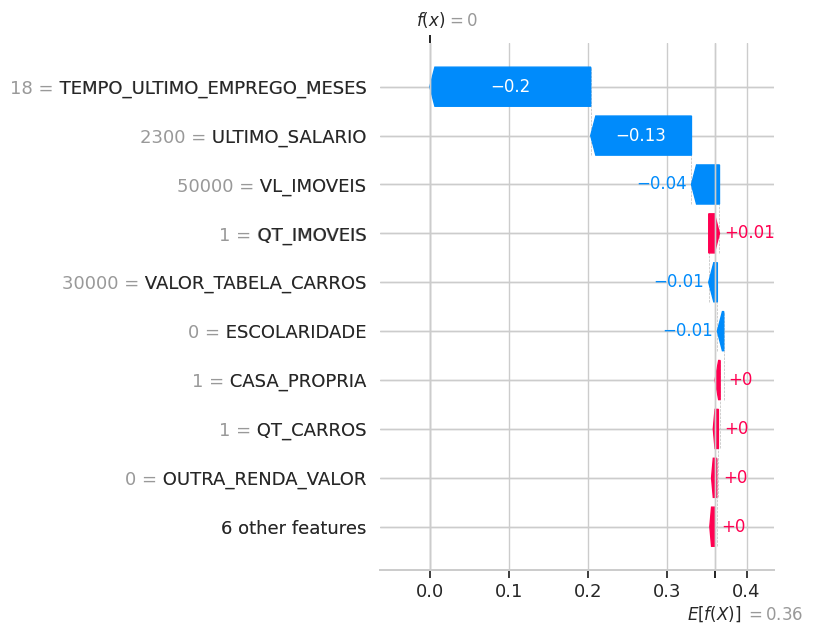

In [ ]:
# -*- coding: utf-8 -*-
import numpy as np
import pandas as pd
import shap
import lime.lime_tabular
import eli5
from eli5 import format_as_html
from anchor import anchor_tabular
from IPython.display import display, HTML
import matplotlib.pyplot as plt
import pickle
import warnings
warnings.filterwarnings("ignore")

# ============================
# 1) Carregar dados e modelo
# ============================
file_path_X = '/content/drive/MyDrive/Colab Notebooks/TCC/X.pkl'
X = pickle.load(open(file_path_X, 'rb'))

file_path_y = '/content/drive/MyDrive/Colab Notebooks/TCC/y.pkl'
y = pickle.load(open(file_path_y, 'rb'))

file_path_X_train = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train.pkl'
X_train = pickle.load(open(file_path_X_train, 'rb'))

file_path_X_test = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test.pkl'
X_test = pickle.load(open(file_path_X_test, 'rb'))

file_path_X_train_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_train_scaled.pkl'
X_train_scaled = pickle.load(open(file_path_X_train_scaled, 'rb'))

file_path_X_test_scaled = '/content/drive/MyDrive/Colab Notebooks/TCC/X_test_scaled.pkl'
X_test_scaled = pickle.load(open(file_path_X_test_scaled, 'rb'))

# Modelo e scaler
lr_model = pickle.load(open('/content/drive/MyDrive/Colab Notebooks/TCC/modelo_regressao.pkl', 'rb'))
scaler = pickle.load(open('/content/drive/MyDrive/Colab Notebooks/TCC/scaler.pkl', 'rb'))

# Names
if isinstance(X_train, pd.DataFrame):
    feature_names = list(X_train.columns)
else:
    # fallback
    feature_names = [f'f{i}' for i in range(X_train.shape[1])]

# ============================
# 2) Dados de entrada
# ============================
novos_dados = [2, 0, 0, 1, 1, 1, 50000, 0, 0, 18, 1, 2300.0, 1, 30000, 2]
X_input = np.array(novos_dados).reshape(1, -1)
X_input_df = pd.DataFrame(X_input, columns=feature_names)

# Funções de predição no espaço ORIGINAL das features
def predict_proba_original(X_array_like):
    """Recebe X em espaço original, aplica scaler e retorna proba da classe 1."""
    df = pd.DataFrame(X_array_like, columns=feature_names)
    scaled = scaler.transform(df)
    if hasattr(lr_model, "predict_proba"):
        proba = lr_model.predict_proba(scaled)  # (n,2)
        return proba
    # fallback: se for regressão com saída contínua, converte para proba fake (sigmoid)
    pred = lr_model.predict(scaled).reshape(-1, 1)
    from scipy.special import expit
    p1 = expit(pred)
    return np.hstack([1 - p1, p1])

def predict_label_original(X_array_like):
    """Predição de rótulos (0/1) a partir do espaço original."""
    df = pd.DataFrame(X_array_like, columns=feature_names)
    scaled = scaler.transform(df)
    if hasattr(lr_model, "predict"):
        return lr_model.predict(scaled)
    # fallback
    return (predict_proba_original(X_array_like)[:, 1] >= 0.5).astype(int)

# Previsão
y_pred = int(predict_label_original(X_input_df.values)[0])
resultado_texto = "Aprovado" if y_pred == 1 else "Recusado"
display(HTML(f"<h3 style='color: {'green' if y_pred==1 else 'red'}'>Resultado: {resultado_texto}</h3>"))

# ============================
# 3) SHAP (robusto a qualquer modelo)
# ============================
try:
    display(HTML("<h4>📊 Explicação com SHAP:</h4>"))

    # Background sample no espaço original (sem scaler)
    # usa amostra para acelerar o KernelExplainer
    def _sample_background(df, n=100):
        n = min(n, len(df))
        return df.sample(n, random_state=42) if hasattr(df, "sample") else pd.DataFrame(df[:n], columns=feature_names)
    background = _sample_background(X_train, n=100)
    background_np = background.values

    # Explainer no espaço original (predict_proba classe 1)
    f_for_shap = lambda Xarr: predict_proba_original(Xarr)[:, 1]
    explainer = shap.KernelExplainer(f_for_shap, background_np)

    # shap values para a instância
    # nsamples equilibrado para velocidade/estabilidade; ajuste se quiser
    shap_vals = explainer.shap_values(X_input_df.values, nsamples=200)
    # KernelExplainer com saída escalar -> retorna array (1, n_features)
    if isinstance(shap_vals, list):
        # caso o f_for_shap retornasse 2 colunas; aqui não acontece, mas fica o guard
        shap_values_instance = shap_vals[1][0]
        base_value = explainer.expected_value[1]
    else:
        shap_values_instance = shap_vals[0]
        base_value = explainer.expected_value

    # Monta Explanation para waterfall
    shap_expl = shap.Explanation(
        values=shap_values_instance,
        base_values=base_value,
        data=X_input_df.iloc[0].values,
        feature_names=feature_names
    )

    # Plot
    plt.figure()
    shap.plots.waterfall(shap_expl, max_display=10, show=False)
    plt.tight_layout()
    plt.show()

    # Principais fatores de acordo com o resultado
    if y_pred == 0:
        # Recusado -> fatores mais negativos
        idx = np.argsort(shap_values_instance)[:3]
        display(HTML("<b>Principais fatores que influenciaram a recusa:</b>"))
    else:
        # Aprovado -> fatores mais positivos
        idx = np.argsort(shap_values_instance)[-3:][::-1]
        display(HTML("<b>Principais fatores que influenciaram a aprovação:</b>"))

    for j in idx:
        contrib = shap_values_instance[j]
        val = X_input_df.iloc[0, j]
        display(HTML(f"{feature_names[j]} (contribuição SHAP: {contrib:+.2f}, valor: {val})"))

except Exception as e:
    display(HTML(f"<span style='color:orange'>Não foi possível gerar SHAP: {e}</span>"))

# ============================
# 4) LIME (intervalos/ranges)
# ============================
try:
    display(HTML("<h4>🧠 Explicação com LIME:</h4>"))

    # LIME usa treinamento no espaço original
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=np.array(X_train.values if isinstance(X_train, pd.DataFrame) else X_train),
        feature_names=feature_names,
        class_names=['Recusado', 'Aprovado'],
        discretize_continuous=True,
        mode='classification',
        kernel_width=None,  # default
        random_state=42
    )

    # predict_fn que aplica scaler internamente e retorna proba 2 colunas
    def lime_predict_fn(x_arr):
        # recebe numpy (n, d) no espaço original
        proba = predict_proba_original(x_arr)
        return proba

    lime_exp = lime_explainer.explain_instance(
        data_row=X_input_df.values[0],
        predict_fn=lime_predict_fn,
        num_features=5,
        top_labels=1
    )

    # Coletar as regras/intervalos do label 1 (Aprovado) OU 0 (Recusado).
    # Para manter a sua formatação pedida: lista textual tipo "0.00 < VL_IMOVEIS ≤ 185000.00"
    # O LIME retorna pares (feature_interval_str, weight); usamos apenas o texto.
    label_to_show = 1 if y_pred == 1 else 0
    rules = [t[0] for t in lime_exp.as_list(label=label_to_show)]

    display(HTML(f"<b>LIME – Principais fatores:</b> {rules}"))

    # LIME espera dados no domínio original; predict_fn recebe dados originais e aplica scaler
    predict_fn = lambda z: model.predict_proba(scaler.transform(_ensure_numpy_2d(z)))
    lime_exp = lime_explainer.explain_instance(X_input[0], predict_fn, num_features=min(8, len(feature_names)))
    try:
        lime_exp.show_in_notebook(show_table=True)
    except Exception:
        display(HTML('<b>LIME (top contribuições):</b>'))
        for f, w in lime_exp.as_list():
            display(HTML(f"<b>{f}</b>: {w:.4f}"))
except Exception as e:
    display(HTML(f"<b style='color:orange'>[AVISO] LIME falhou: {e}</b>"))


except Exception as e:
    display(HTML(f"<span style='color:orange'>Não foi possível gerar LIME: {e}</span>"))


# ============================
# 5) ELI5
# ============================

display(HTML('<h3>🔍 ELI5 — explicação local</h3>'))
try:
    feature_names_list = feature_names
    eli5_html = eli5.explain_prediction(model, X_scaled_df.iloc[0], feature_names=feature_names_list)
    display(HTML('<b>ELI5 — explicação para a instância:</b>'))
    display(eli5.show_prediction(model, X_scaled_df.iloc[0], feature_names=feature_names_list))
except Exception as e:
    display(HTML(f"<b style='color:orange'>[AVISO] ELI5 falhou: {e}</b>"))


# ============================
# 6) Anchor
# ============================
try:
    display(HTML("<h4>📜 Explicação com Anchor:</h4>"))

    def predict_fn_anchor(arr2d):
        # retorna rótulos 0/1
        return predict_label_original(arr2d)

    # Anchor usa dados de treino no espaço original
    anchor_explainer = anchor_tabular.AnchorTabularExplainer(
        class_names=['Recusado', 'Aprovado'],
        feature_names=feature_names,
        train_data=np.array(X_train.values if isinstance(X_train, pd.DataFrame) else X_train)
    )

    anchor_exp = anchor_explainer.explain_instance(
        X_input_df.values[0],
        predict_fn_anchor,
        threshold=0.95
    )
    rule = " E ".join(anchor_exp.names())
    display(HTML(f"<b>Regra gerada: Se {rule}, então o resultado é {resultado_texto}</b>"))
    display(HTML(f"Precisão: {anchor_exp.precision():.2f} | Cobertura: {anchor_exp.coverage():.2f}"))

except Exception as e:
    display(HTML(f"<span style='color:orange'>Não foi possível gerar Anchor: {e}</span>"))
